# Dogs and Wolves Simple CNN

## Step 1 - Import Libraries

In [1]:
import warnings
warnings.simplefilter("ignore")

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
import shap
import torch
import torch.nn as nn
import torch.optim as optim

from pathlib import Path

SEED = 42
torch.manual_seed(SEED)
np.random.seed(SEED)

print("PyTorch version:", torch.__version__)
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("device:", DEVICE)

PyTorch version: 2.5.1
device: cpu


In [3]:
import torchvision
from torchvision import datasets, transforms
from torchvision.utils import make_grid
from torch.utils.data import random_split, DataLoader

In [4]:
from utils import (
    GradCAM,
    SimpleCNN,
)

from utils import (
    get_class_names_from_idxs,
    plot_class_distribution,
    train_model,
    evaluate_model,
    plot_training_metrics,
    convert_np_to_tensor,
    model_predict,
)

from utils import (
    gradcam_explain_image,
    lime_explain_image,
    shap_explain_images
)

## Step 2 - Load the dataset

> Sample pictures colected from [https://www.kaggle.com/datasets/harishvutukuri/dogs-vs-wolves?resource=download](https://www.kaggle.com/datasets/harishvutukuri/dogs-vs-wolves?resource=download)

In [5]:
PROJECT_DIR = "/Users/brusnto/Doutorado/XAI/ProjetoFinal"
DATASET_NAME = "dogs_wolves"

DATA_ROOT = f"{PROJECT_DIR}/datasets/{DATASET_NAME}"
MODELS_PATH = f"{PROJECT_DIR}/models"
METRICS_PATH = f"{PROJECT_DIR}/metrics"

MODEL_FILE_NAME = f"{MODELS_PATH}/{DATASET_NAME}_simpleCNN.pth"
METRICS_FILE_NAME =  METRICS_PATH + "/{type}_" + DATASET_NAME + "_simpleCNN.pkl"

BATCH_SIZE = 64

print(f"Model file: {MODEL_FILE_NAME}")
print(f"Model file: {METRICS_FILE_NAME}")

Model file: /Users/brusnto/Doutorado/XAI/ProjetoFinal/models/dogs_wolves_simpleCNN.pth
Model file: /Users/brusnto/Doutorado/XAI/ProjetoFinal/metrics/{type}_dogs_wolves_simpleCNN.pkl


In [6]:
Path(MODELS_PATH).mkdir(parents=True, exist_ok=True)
Path(METRICS_PATH).mkdir(parents=True, exist_ok=True)

In [7]:
# Resize all images to 224x224
transform_image_resize = transforms.Compose([
    transforms.Resize(size = (224, 224)),
    transforms.ToTensor(),
])

In [8]:
# Read images
train_ds = datasets.ImageFolder(
    f"{DATA_ROOT}/",
    transform=transform_image_resize
)

print(type(train_ds))

<class 'torchvision.datasets.folder.ImageFolder'>


In [9]:
CLASS_TO_IDX_MAP = train_ds.class_to_idx
CLASS_NAMES = list(CLASS_TO_IDX_MAP.keys())
N_CLASSES = len(CLASS_NAMES)

CLASS_TO_IDX_MAP

{'dogs': 0, 'wolves': 1}

In [10]:
# Extract validation and test sets
train_size = int(0.8 * len(train_ds))
val_size = len(train_ds) - train_size

train_ds, val_ds = random_split(train_ds, [train_size, val_size])

train_size = int(0.8 * len(train_ds))
test_size = len(train_ds) - train_size

train_ds, test_ds = random_split(train_ds, [train_size, test_size])

In [11]:
train_loader = DataLoader(
    train_ds,
    batch_size=BATCH_SIZE,
    shuffle=True
)
val_loader = DataLoader(
    val_ds,
    batch_size=BATCH_SIZE,
    shuffle=True
)
test_loader = DataLoader(
    test_ds,
    batch_size=BATCH_SIZE,
    shuffle=False
)
print(type(train_loader))

<class 'torch.utils.data.dataloader.DataLoader'>


In [12]:
total_train = len(train_loader.dataset)
total_val = len(val_loader.dataset)
total_test = len(test_loader.dataset)

print(f"Train: {total_train}")
print(f"Validation: {total_val}")
print(f"Test: {total_test}")
print(f"Total: {total_train + total_val + total_test}")

Train: 1280
Validation: 400
Test: 320
Total: 2000


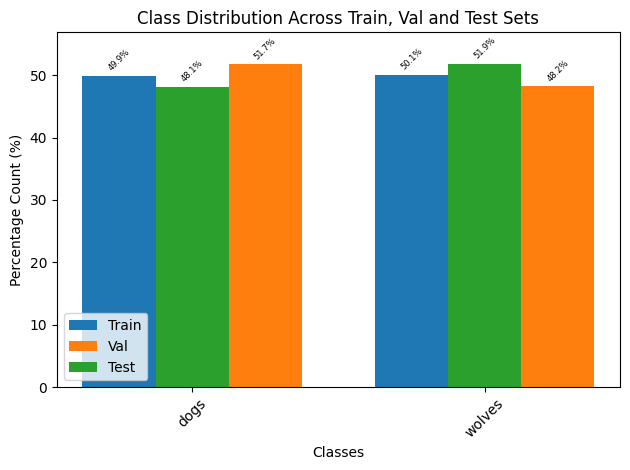

In [13]:
plot_class_distribution(train_ds, val_ds, test_ds, CLASS_NAMES)

In [14]:
sample_train_images, sample_train_torch_labels = next(iter(train_loader))

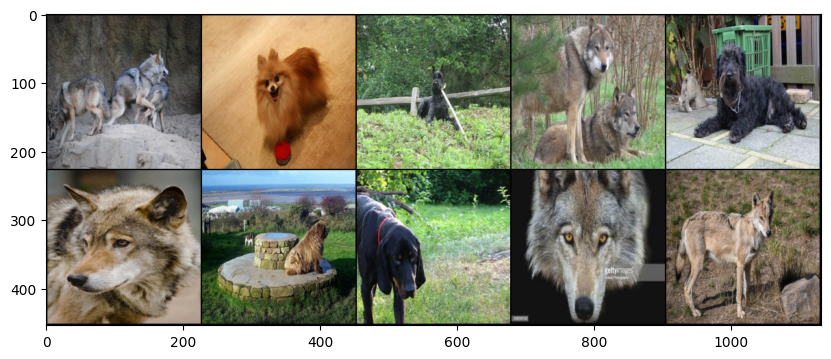

<class 'torch.Tensor'>


In [15]:
# Print 10 first training images
sample_train_images = sample_train_images[:10]
sample_train_torch_labels = sample_train_torch_labels[:10]
grid_img = make_grid(sample_train_images, 5)

%matplotlib inline
plt.figure(figsize = (10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()
print(type(sample_train_images))

## Step 3 - Train CNN

In [16]:
model = SimpleCNN(N_CLASSES).to(DEVICE)
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.9, weight_decay=1e-3)

In [17]:
LOAD_MODEL = True

In [18]:
if LOAD_MODEL:
    model.load_state_dict(torch.load(MODEL_FILE_NAME, map_location=DEVICE))
    # Load the dictionaries from pickle files
    with open(METRICS_FILE_NAME.format(type="train"), "rb") as train_file:
        train_metrics = pickle.load(train_file)
    with open(METRICS_FILE_NAME.format(type="val"), "rb") as val_file:
        val_metrics = pickle.load(val_file)
else:
    train_metrics, val_metrics = train_model(
        model, train_loader, val_loader, criterion, optimizer, DEVICE, CLASS_NAMES, MODEL_FILE_NAME
    )
    # Save the dictionaries as pickle files
    with open(METRICS_FILE_NAME.format(type="train"), "wb") as train_file:
        pickle.dump(train_metrics, train_file)
    with open(METRICS_FILE_NAME.format(type="val"), "wb") as val_file:
        pickle.dump(val_metrics, val_file)

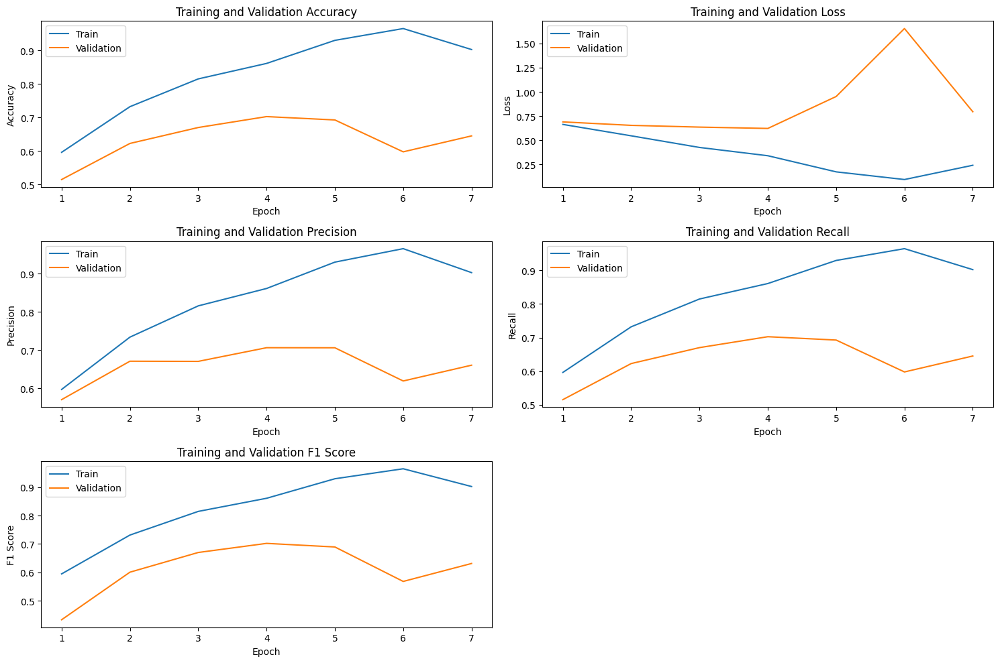

In [19]:
plot_training_metrics(train_metrics, val_metrics)

## Step 4 - Evaluate CNN

In [20]:
test_loss, test_accuracy, test_precision, test_recall, test_f1 = evaluate_model(
    model, test_loader, criterion, DEVICE, CLASS_NAMES, print_cf_report=True
)

print("\nTest Results:")
print(f"Test Loss: {test_loss:.4f}, Accuracy: {test_accuracy:.4f}, Precision: {test_precision:.4f}, Recall: {test_recall:.4f}, F1-Score: {test_f1:.4f}")

              precision    recall  f1-score   support

        dogs       0.57      0.81      0.67       154
      wolves       0.72      0.44      0.54       166

    accuracy                           0.62       320
   macro avg       0.64      0.63      0.61       320
weighted avg       0.65      0.62      0.61       320


Test Results:
Test Loss: 0.8703, Accuracy: 0.6188, Precision: 0.6472, Recall: 0.6188, F1-Score: 0.6060


## Step 5 - Predict Sample Images

In [21]:
sample_images, sample_torch_labels = next(iter(test_loader))
sample_images_dicts = [''] * len(sample_images)

for i in range(len(sample_images)):
    sample_images_dicts[i] = {}
    sample_images_dicts[i]['image'] = sample_images[i]
    sample_images_dicts[i]['label'] = get_class_names_from_idxs(sample_torch_labels[i], CLASS_TO_IDX_MAP)[0]
    predicted = np.argmax(model_predict(model, sample_images[i], DEVICE))
    sample_images_dicts[i]['pred_label'] = get_class_names_from_idxs(predicted, CLASS_TO_IDX_MAP)[0]

## Step 6 - Retrieve LIME Explanation

In [22]:
SAMPLE_TEST_IMAGE_INDEXES = [1, 2, 3, 4, 5, 6, 7, 8, 14, 15, 16, 19, 20, 21, 23, 23, 24, 25, 31, 32, 33, 35, 56, 57, 58]

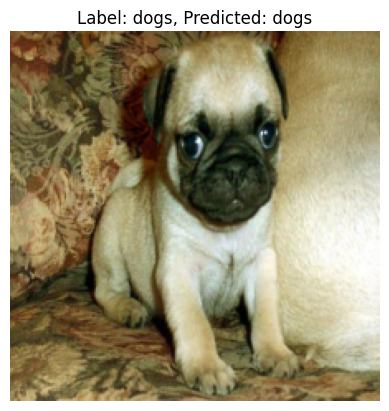

100%|███████████████████████████████████████| 1000/1000 [00:11<00:00, 83.38it/s]


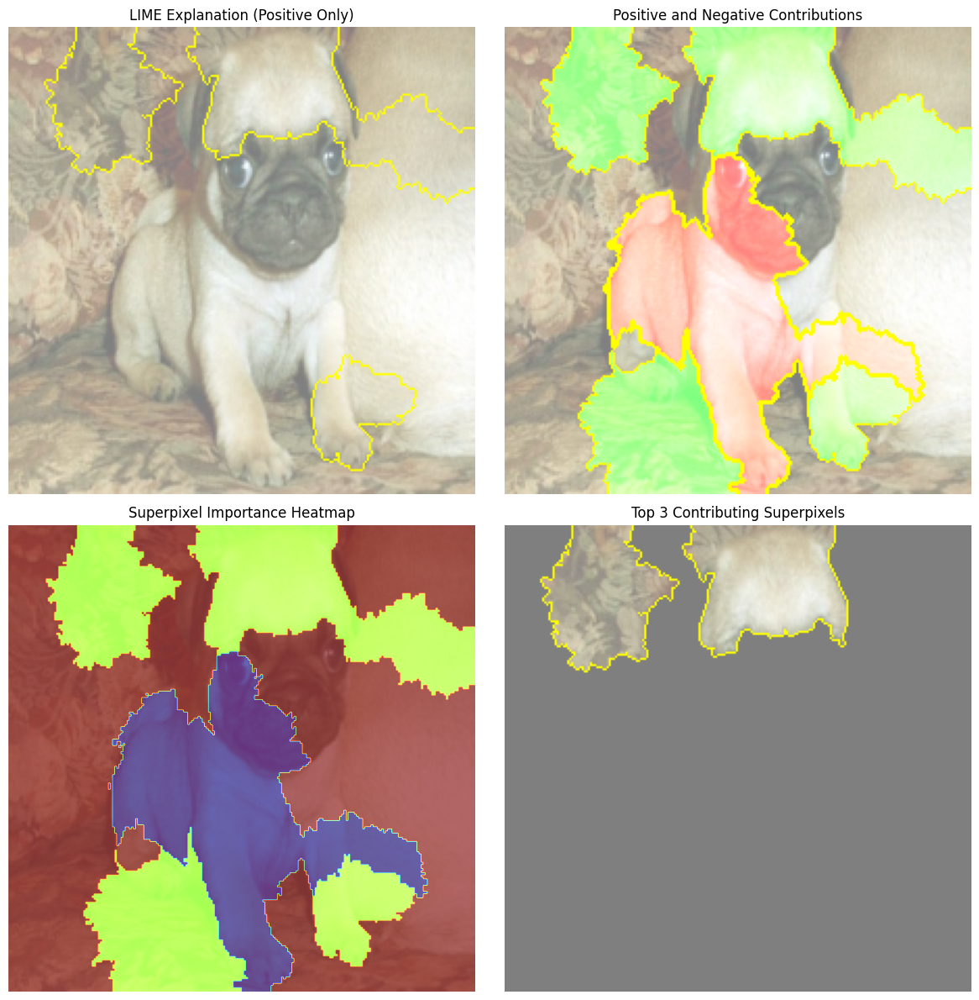

------------------------------------------------------------------------------------------------------------------------


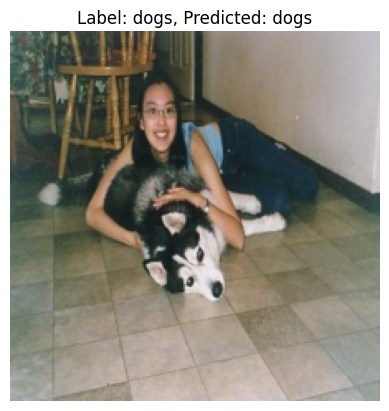

100%|███████████████████████████████████████| 1000/1000 [00:12<00:00, 82.11it/s]


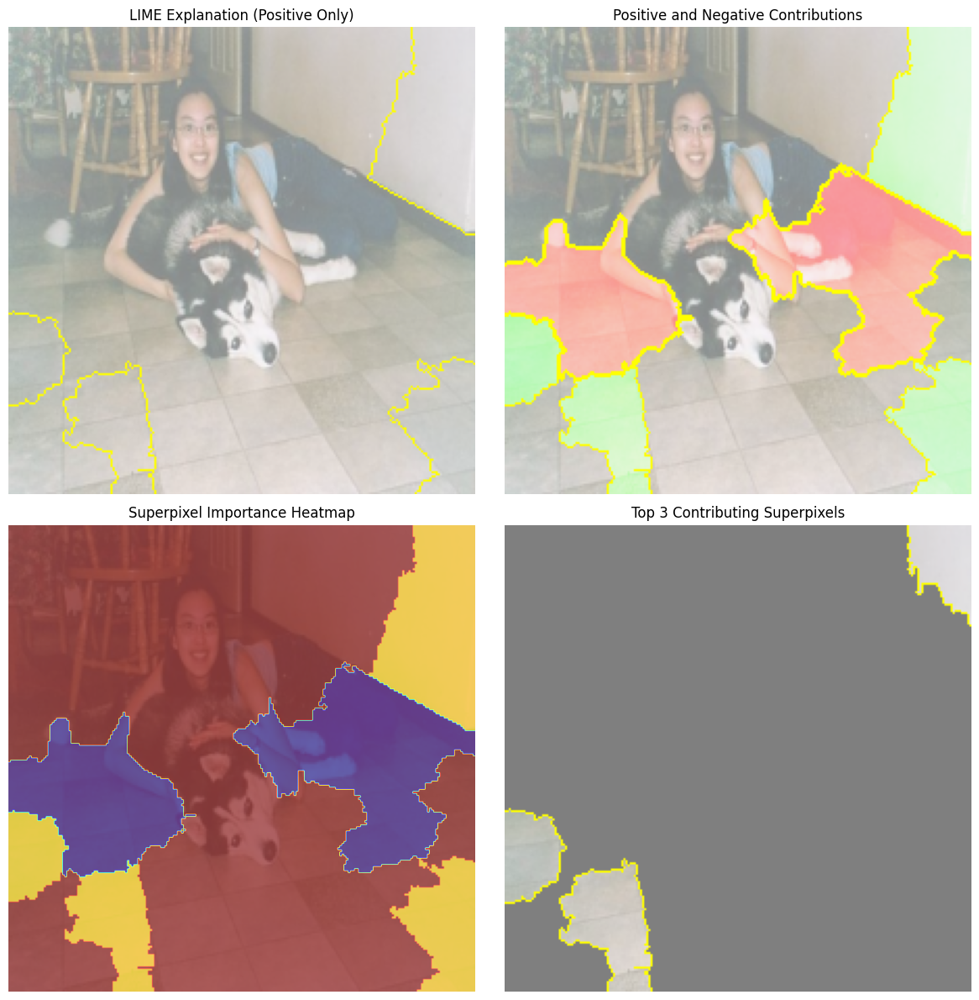

------------------------------------------------------------------------------------------------------------------------


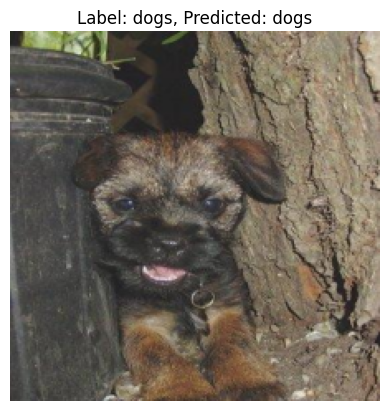

100%|███████████████████████████████████████| 1000/1000 [00:12<00:00, 80.90it/s]


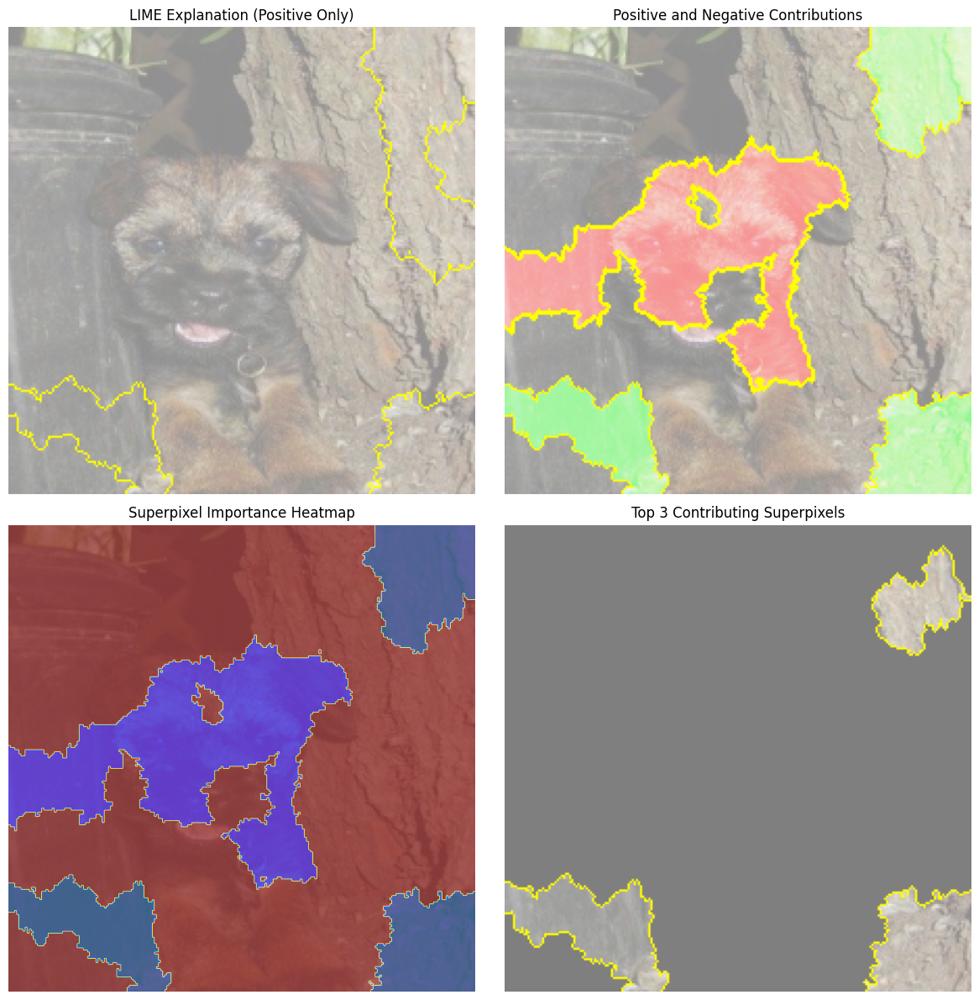

------------------------------------------------------------------------------------------------------------------------


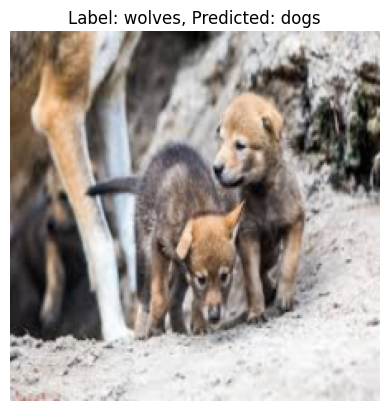

100%|███████████████████████████████████████| 1000/1000 [00:12<00:00, 80.05it/s]


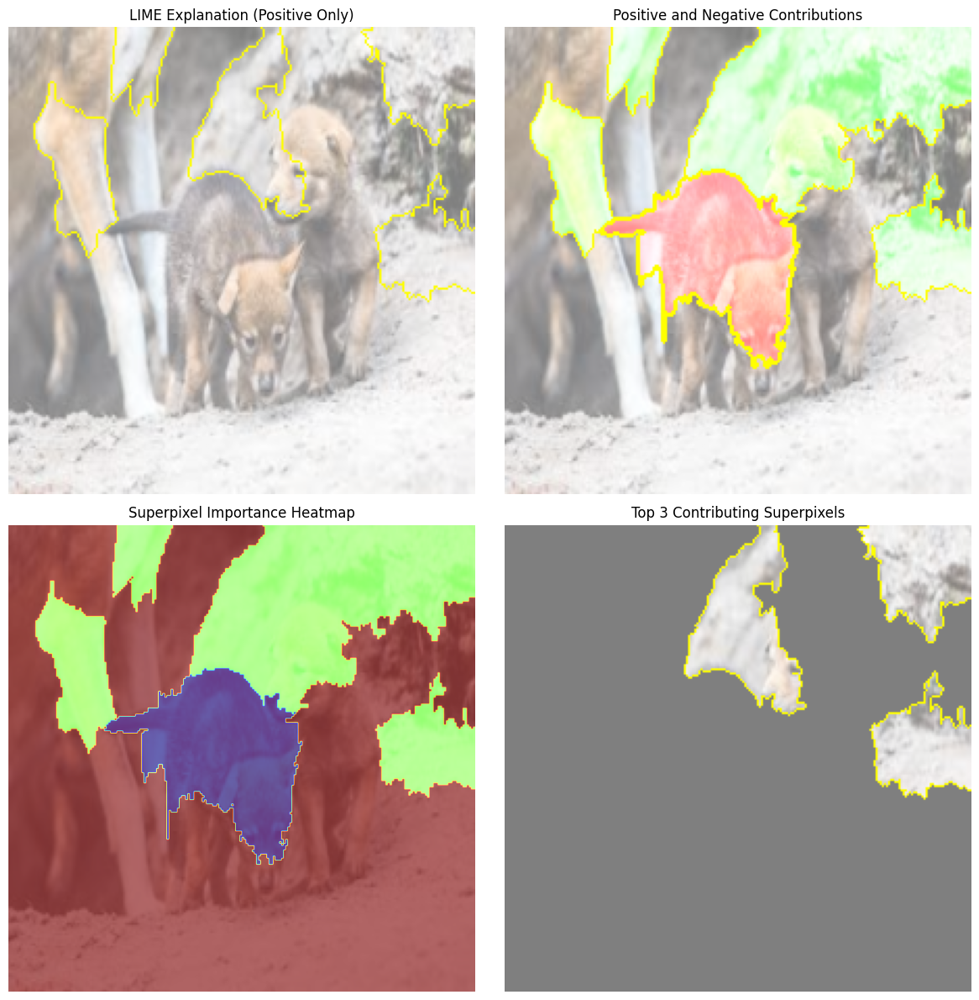

------------------------------------------------------------------------------------------------------------------------


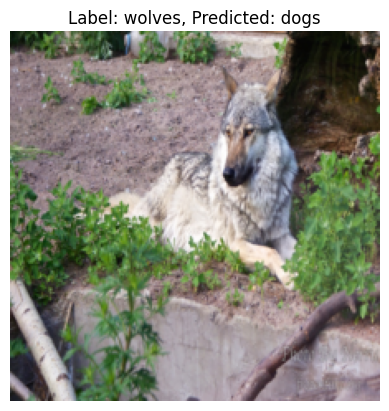

100%|███████████████████████████████████████| 1000/1000 [00:12<00:00, 82.43it/s]


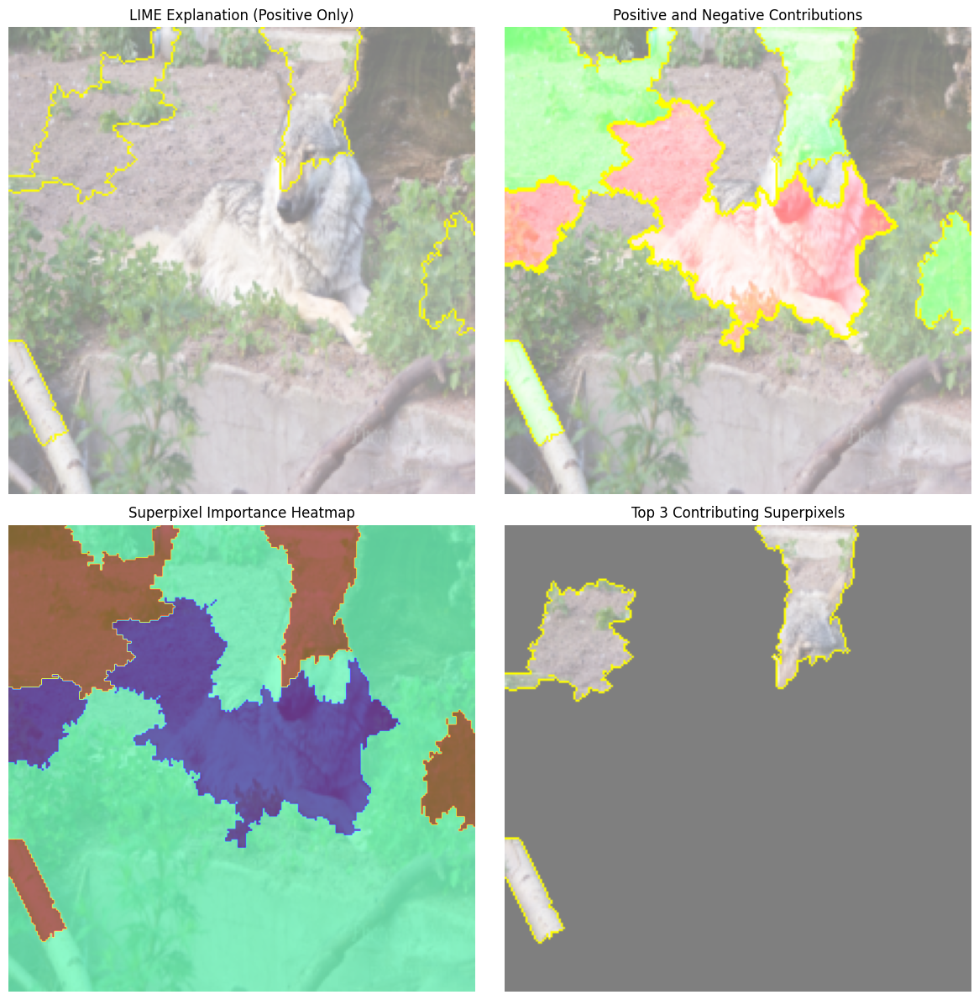

------------------------------------------------------------------------------------------------------------------------


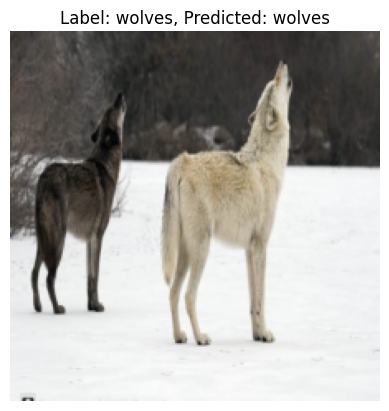

100%|███████████████████████████████████████| 1000/1000 [00:12<00:00, 83.05it/s]


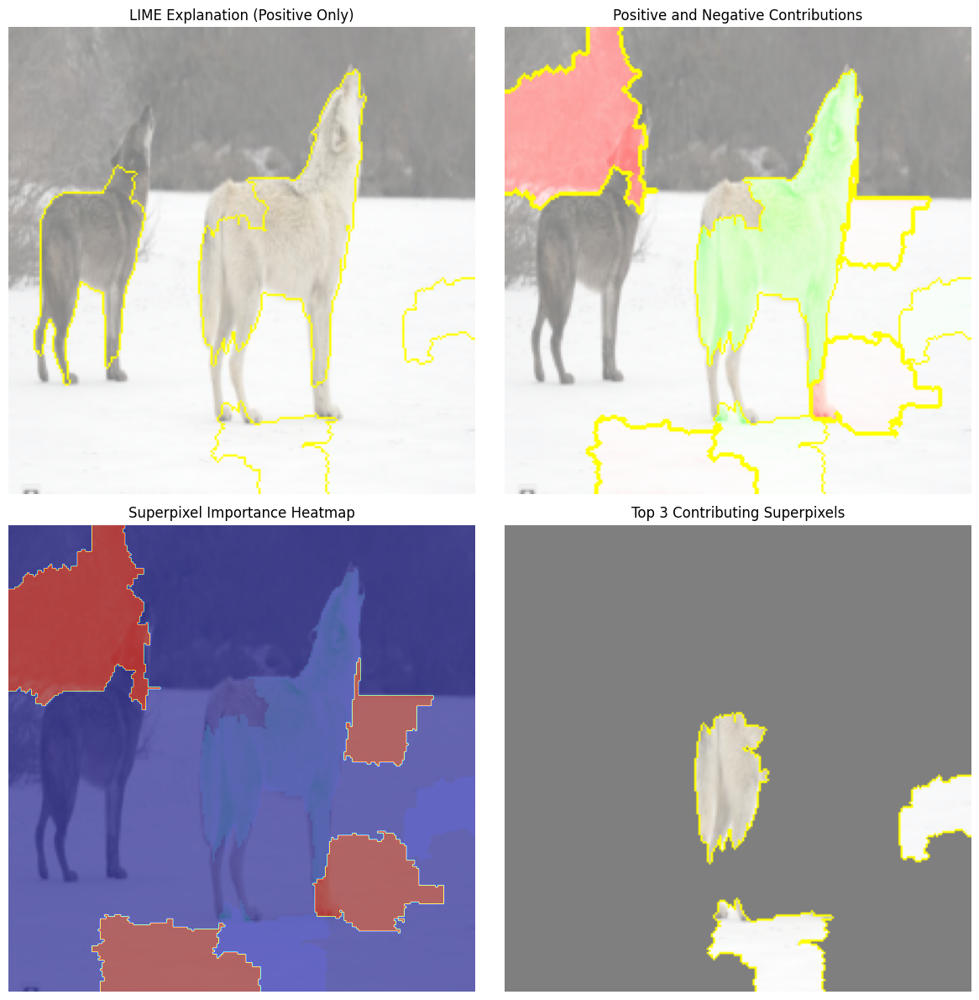

------------------------------------------------------------------------------------------------------------------------


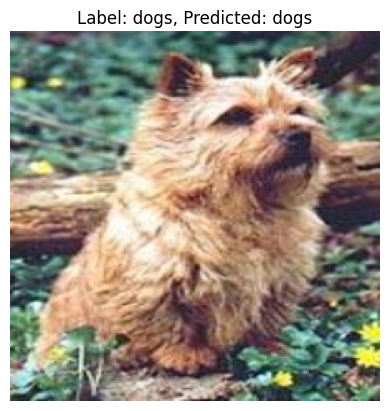

100%|███████████████████████████████████████| 1000/1000 [00:13<00:00, 74.02it/s]


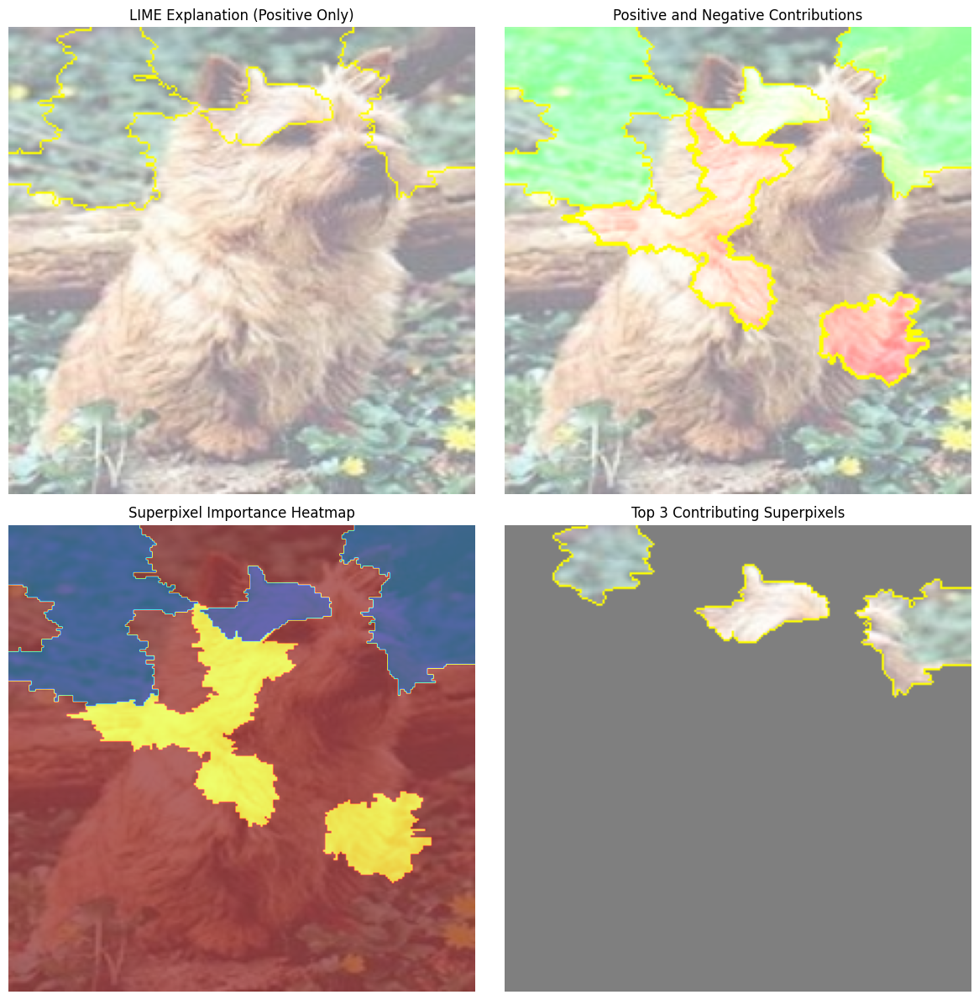

------------------------------------------------------------------------------------------------------------------------


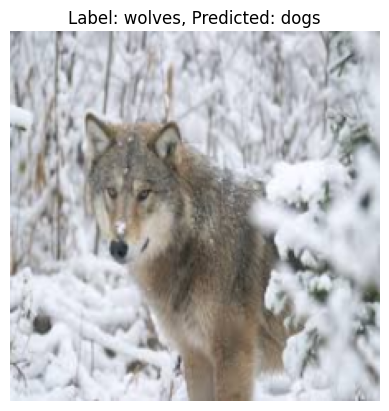

100%|███████████████████████████████████████| 1000/1000 [00:12<00:00, 83.15it/s]


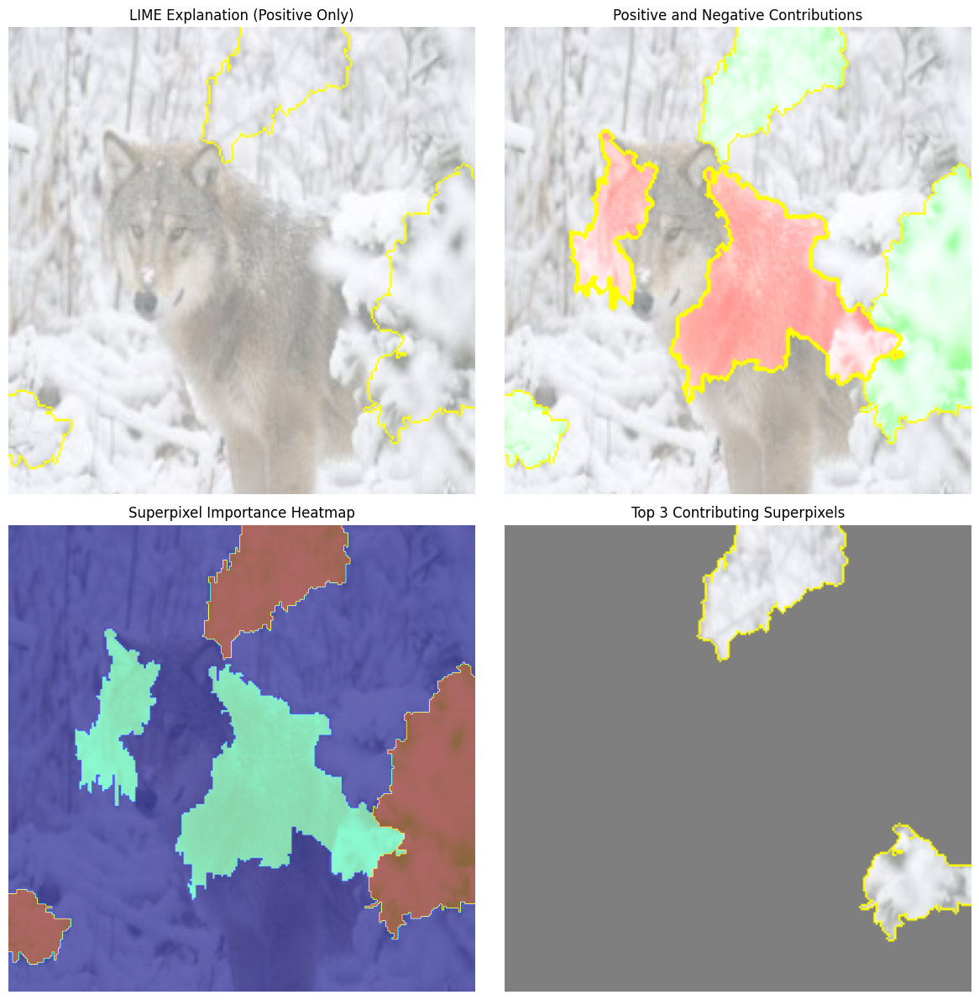

------------------------------------------------------------------------------------------------------------------------


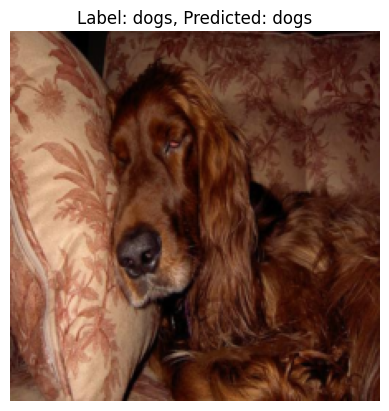

100%|███████████████████████████████████████| 1000/1000 [00:11<00:00, 84.29it/s]


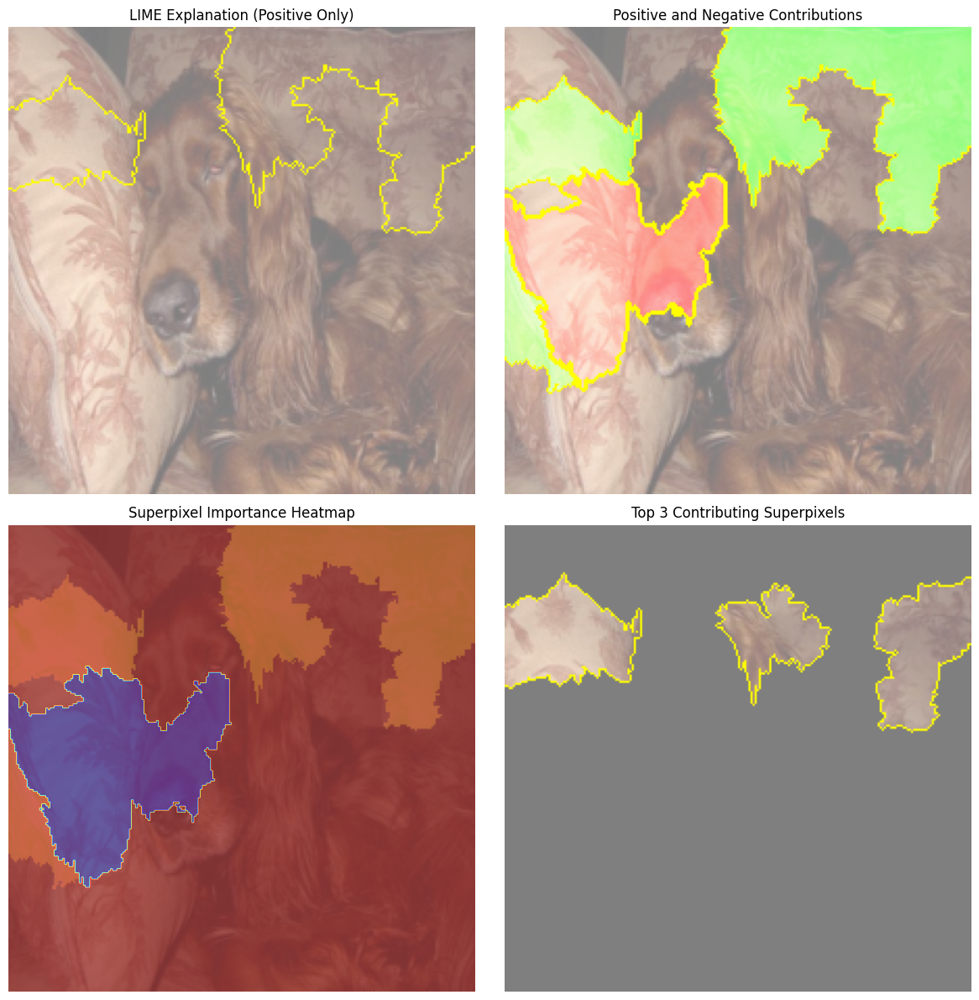

------------------------------------------------------------------------------------------------------------------------


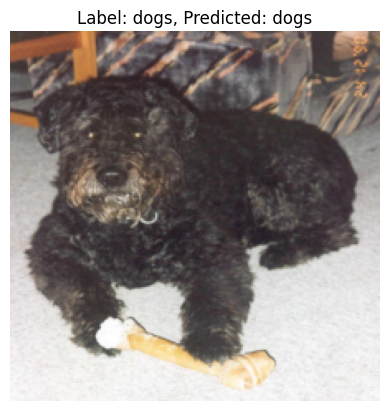

100%|███████████████████████████████████████| 1000/1000 [00:11<00:00, 84.47it/s]


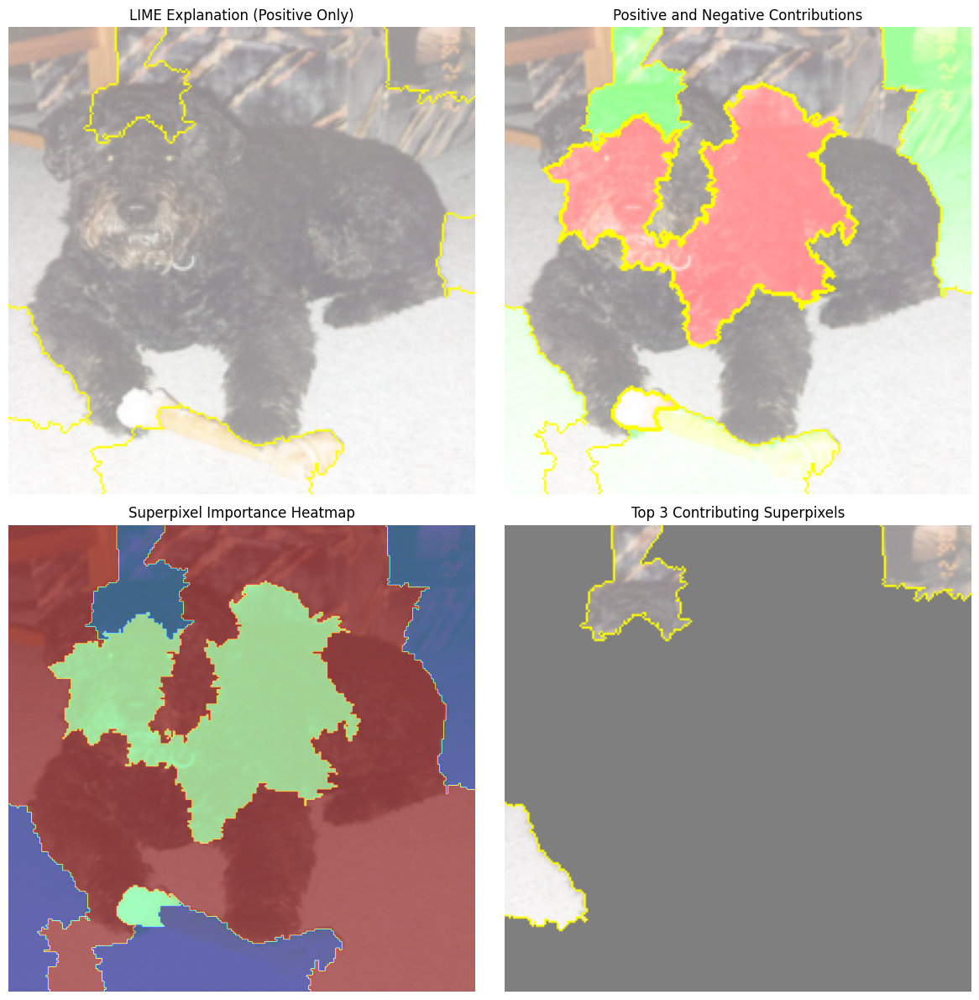

------------------------------------------------------------------------------------------------------------------------


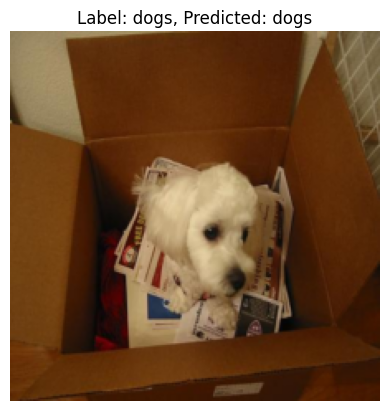

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 99.10it/s]


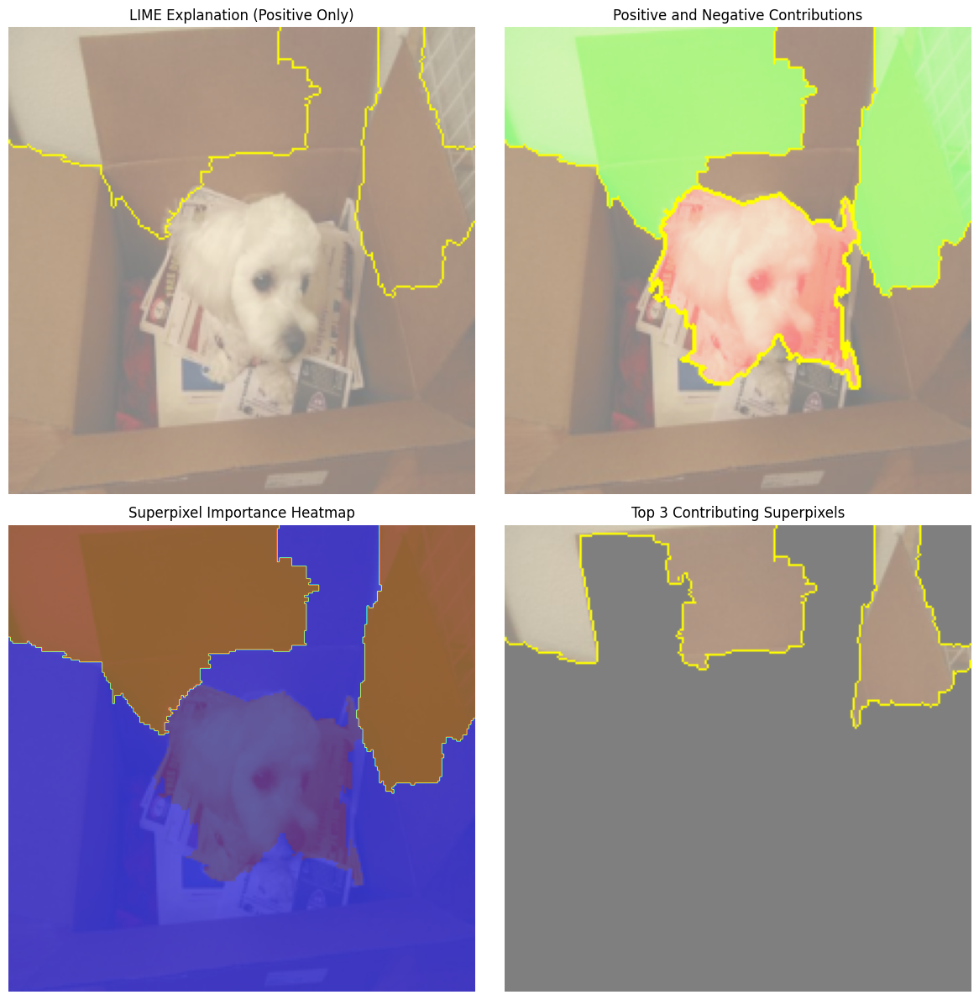

------------------------------------------------------------------------------------------------------------------------


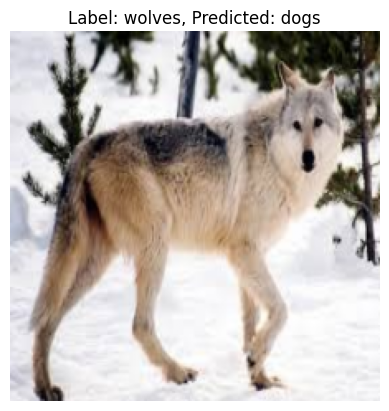

100%|███████████████████████████████████████| 1000/1000 [00:11<00:00, 84.09it/s]


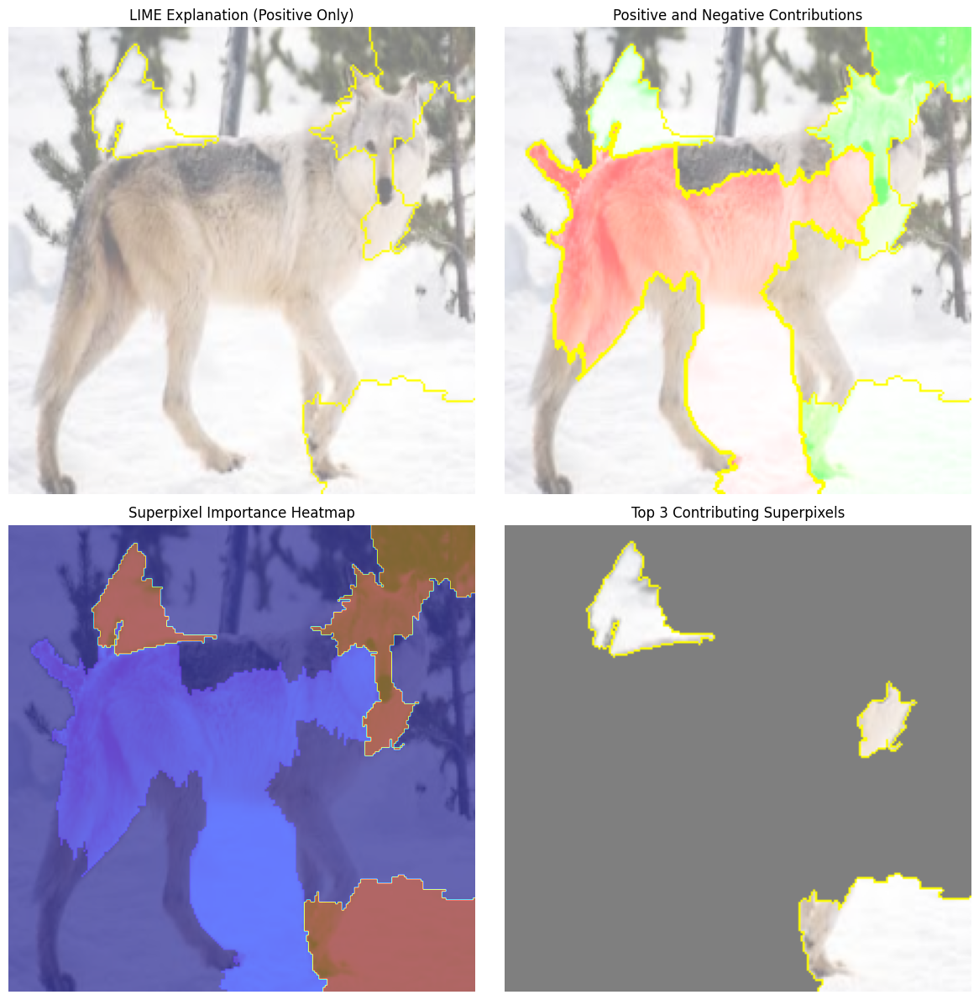

------------------------------------------------------------------------------------------------------------------------


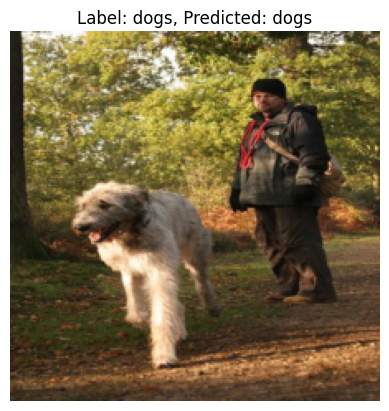

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 91.70it/s]


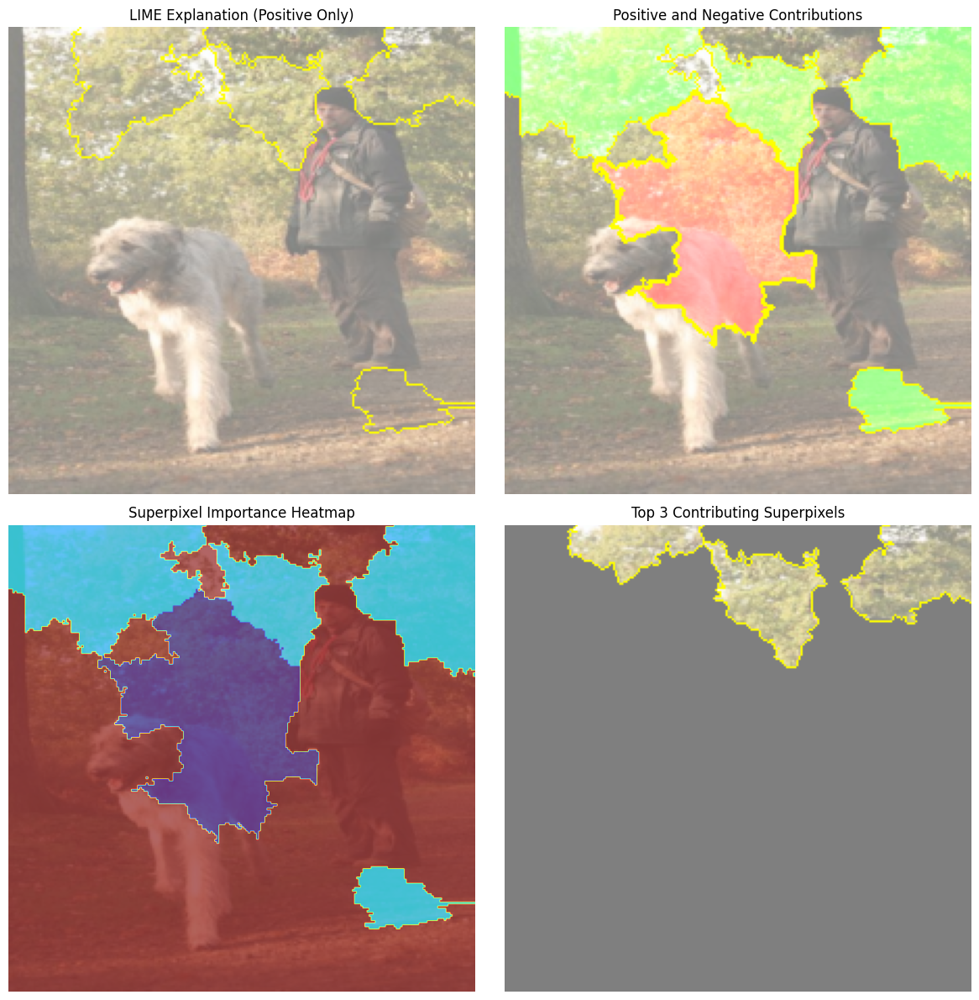

------------------------------------------------------------------------------------------------------------------------


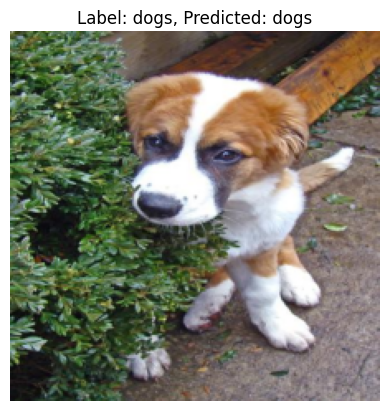

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 96.74it/s]


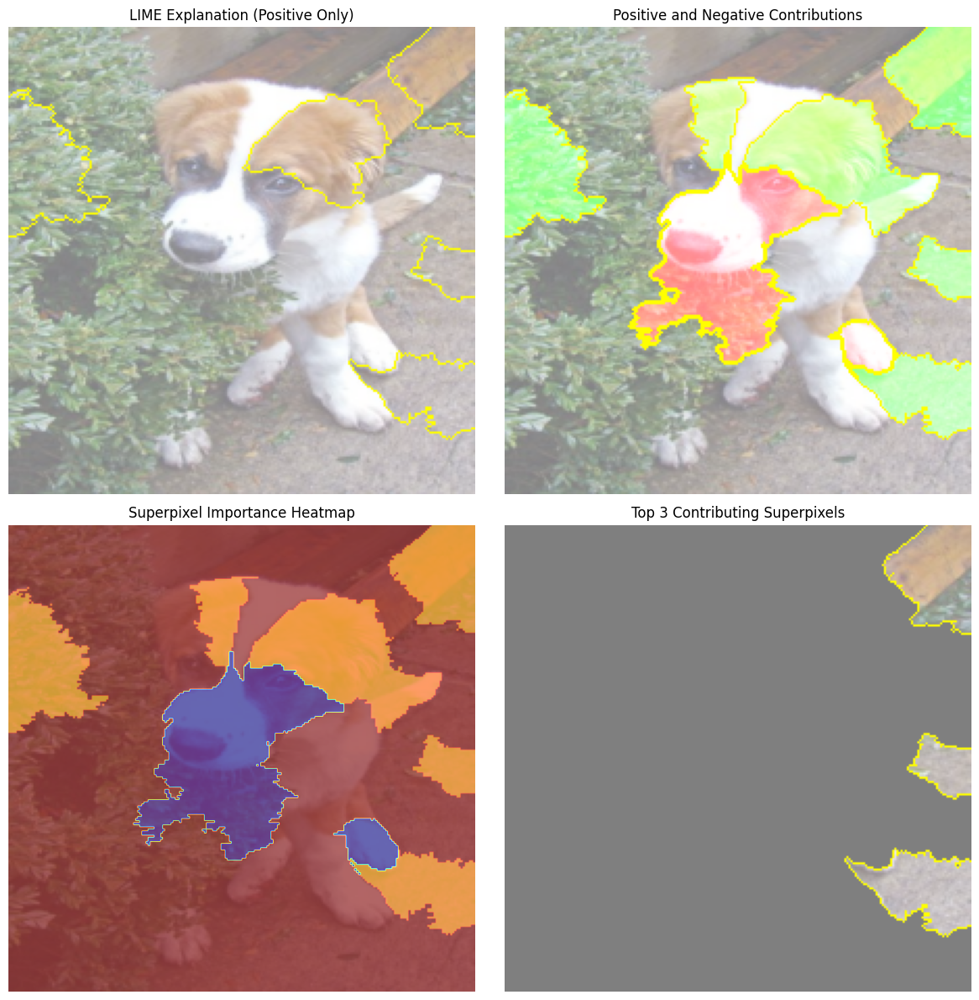

------------------------------------------------------------------------------------------------------------------------


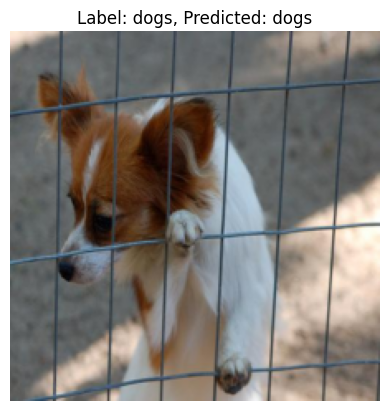

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 92.41it/s]


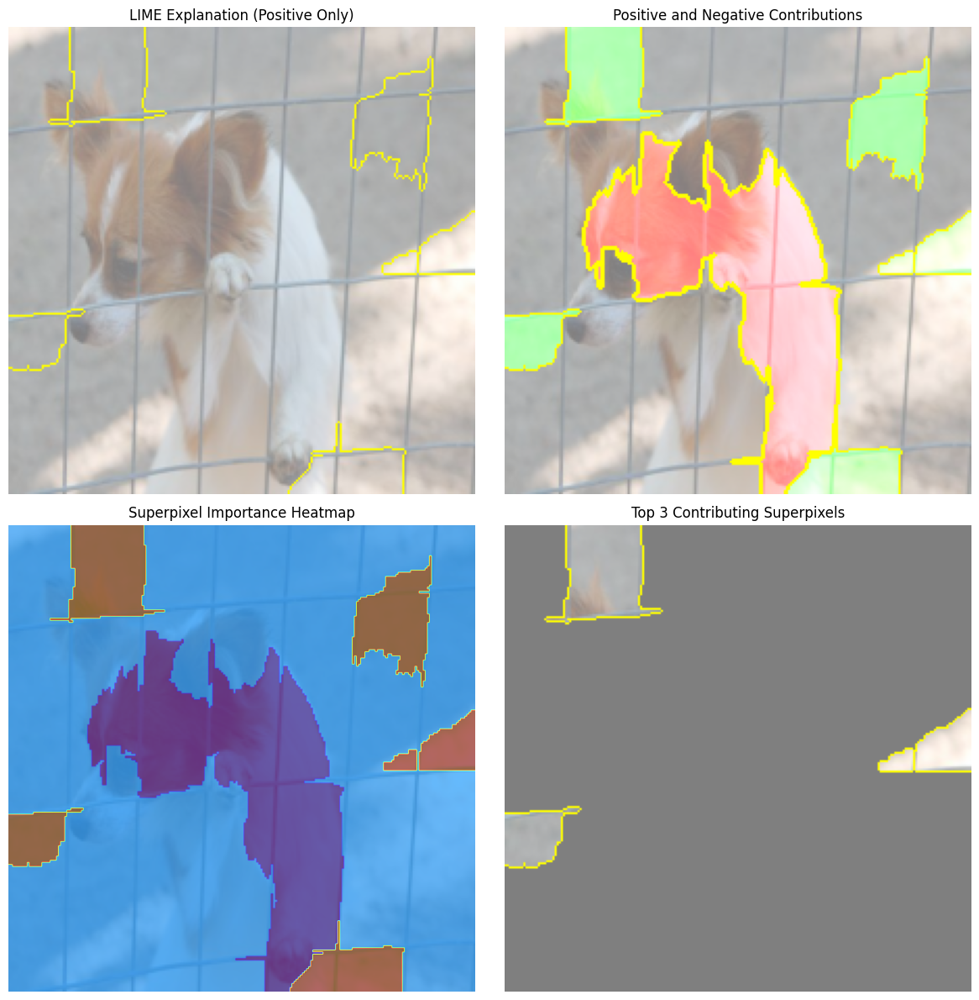

------------------------------------------------------------------------------------------------------------------------


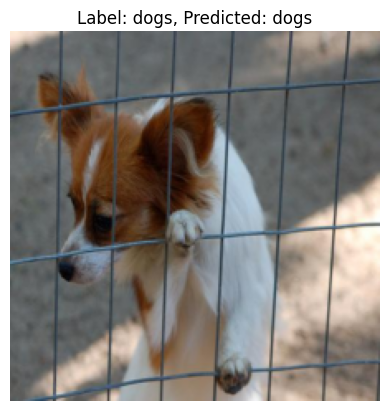

100%|███████████████████████████████████████| 1000/1000 [00:11<00:00, 84.82it/s]


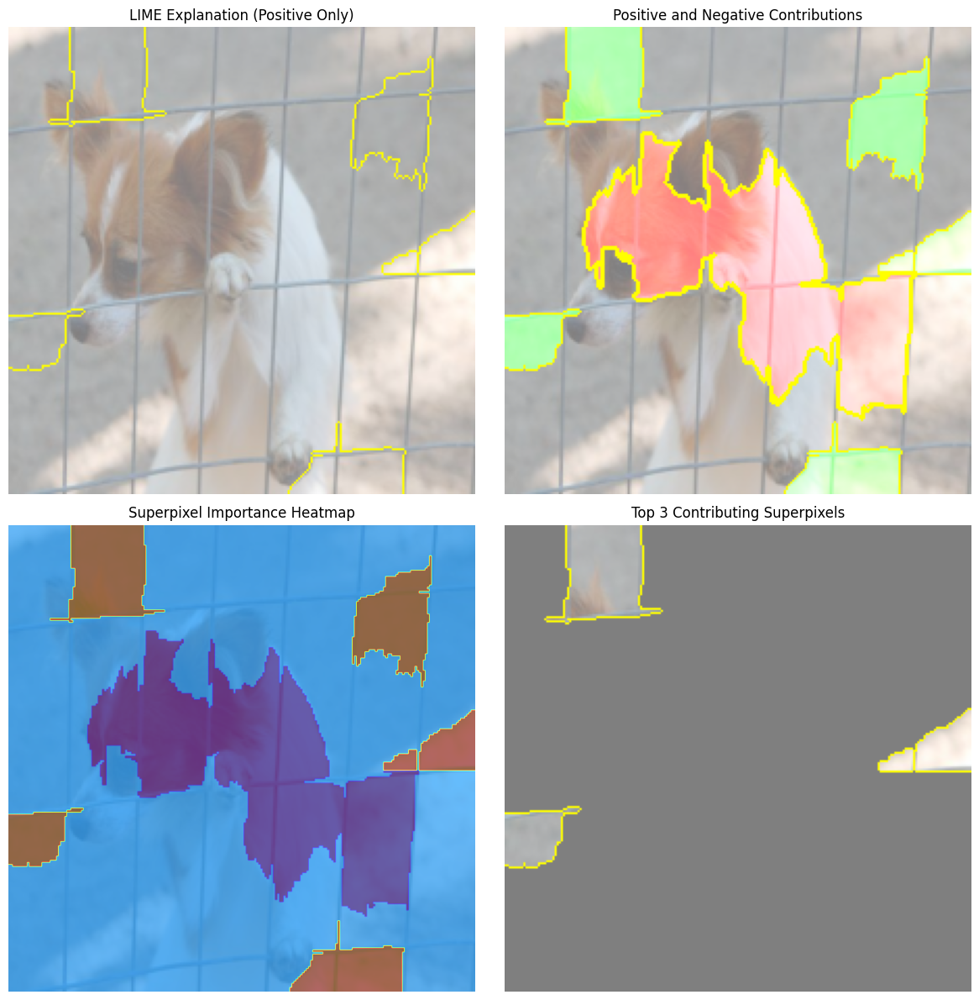

------------------------------------------------------------------------------------------------------------------------


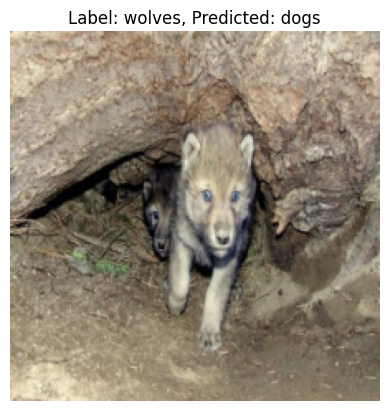

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 93.09it/s]


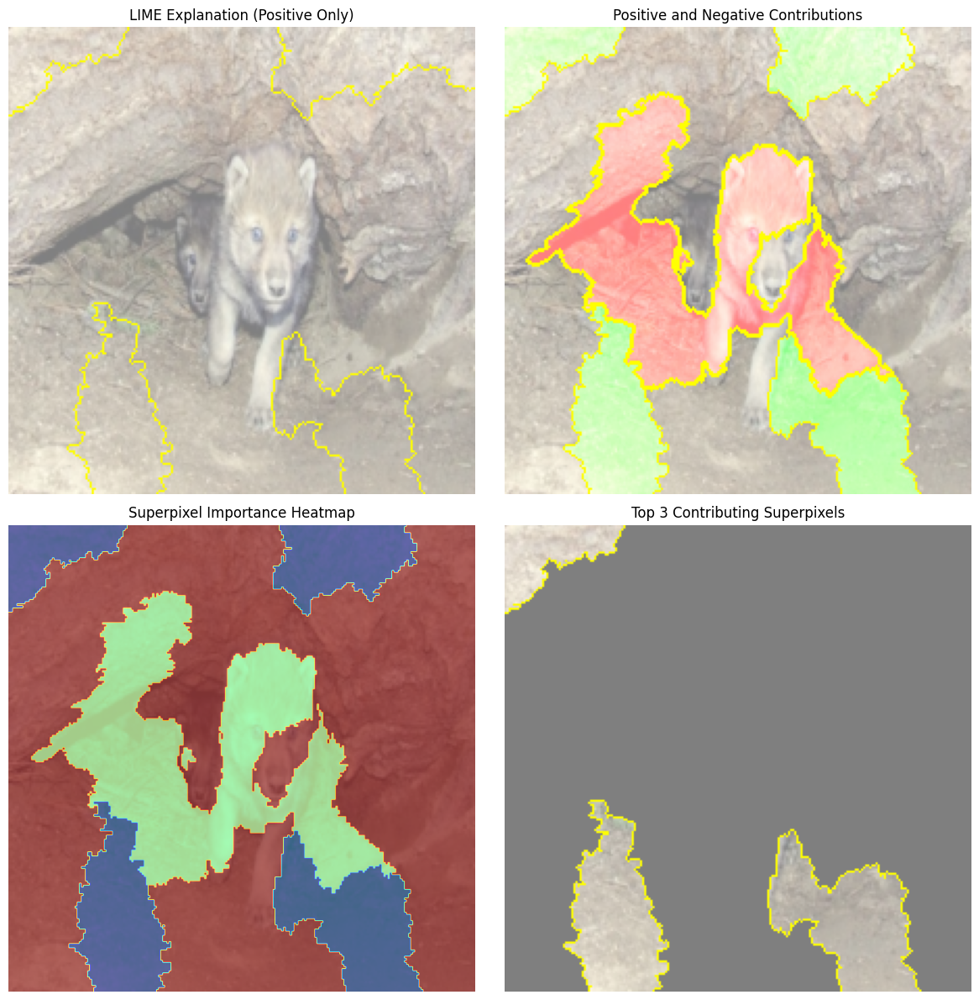

------------------------------------------------------------------------------------------------------------------------


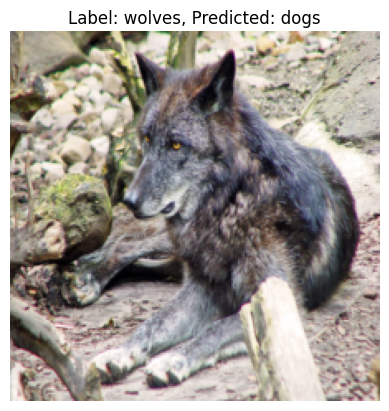

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 93.97it/s]


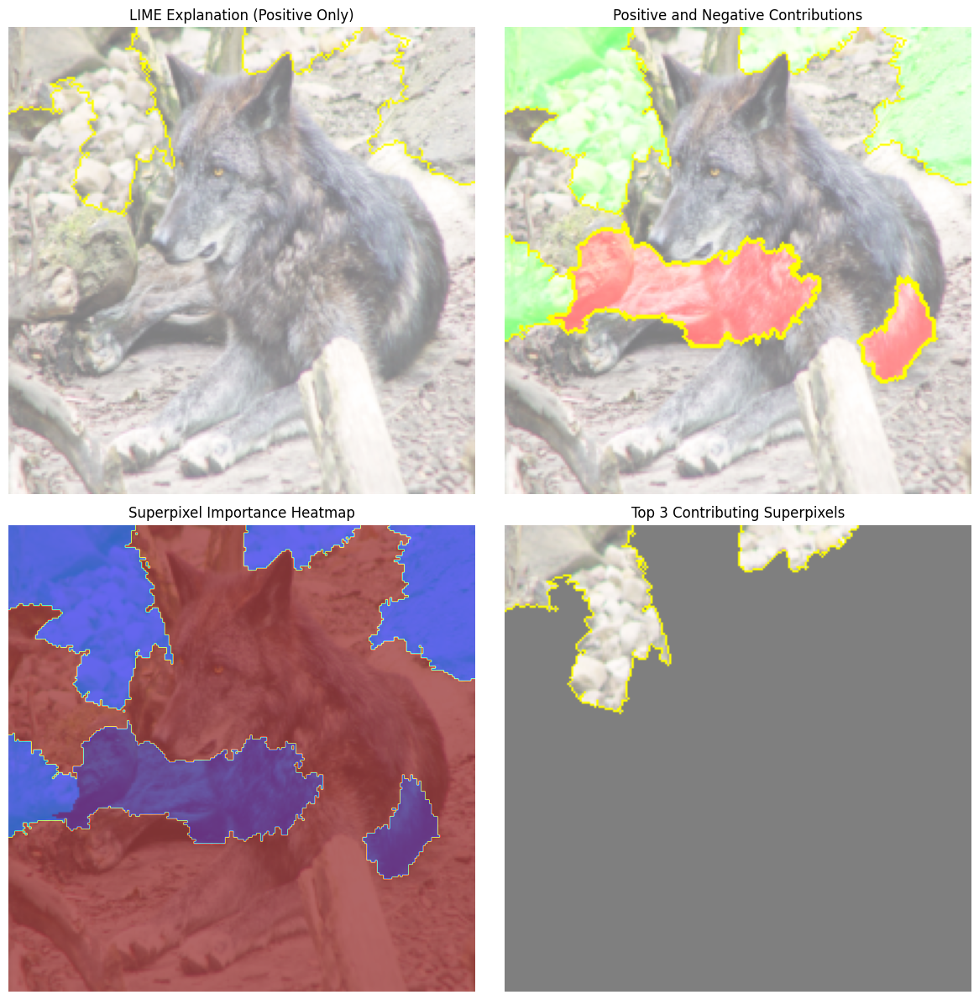

------------------------------------------------------------------------------------------------------------------------


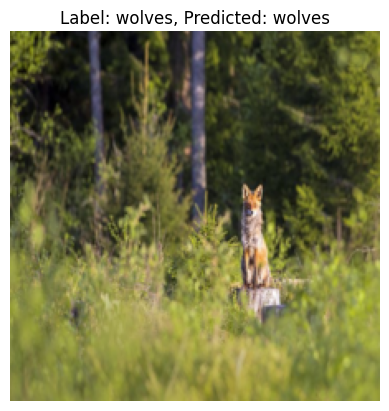

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 93.52it/s]


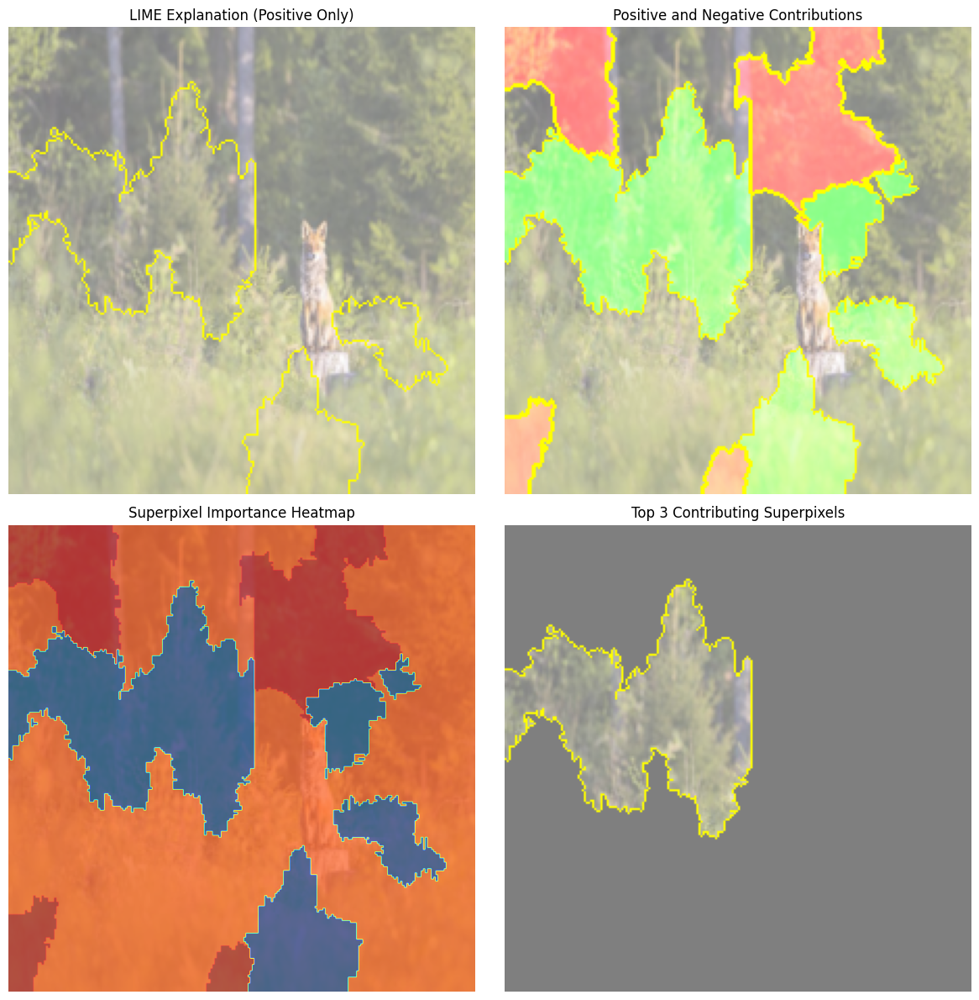

------------------------------------------------------------------------------------------------------------------------


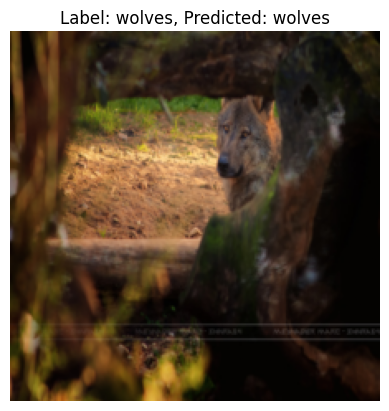

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 92.72it/s]


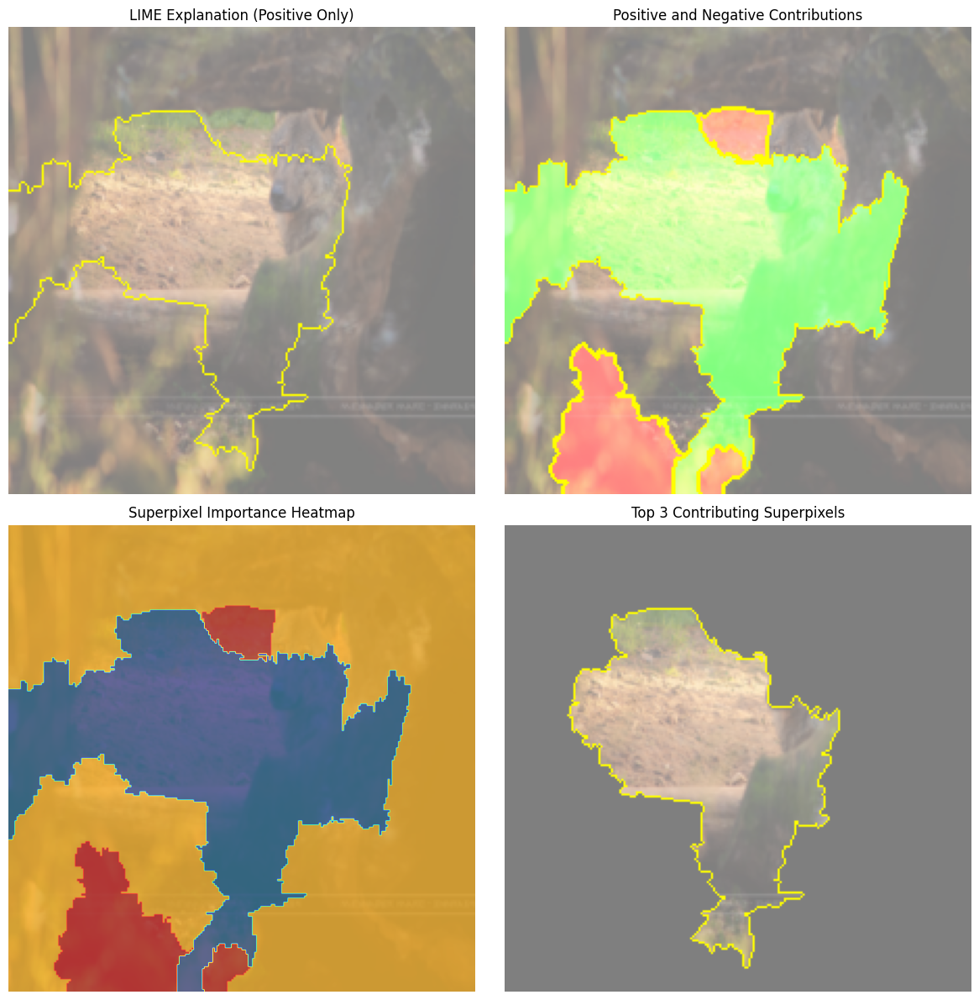

------------------------------------------------------------------------------------------------------------------------


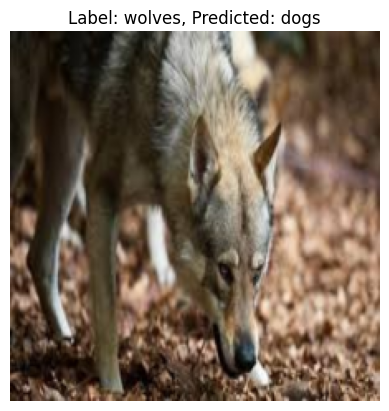

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 92.98it/s]


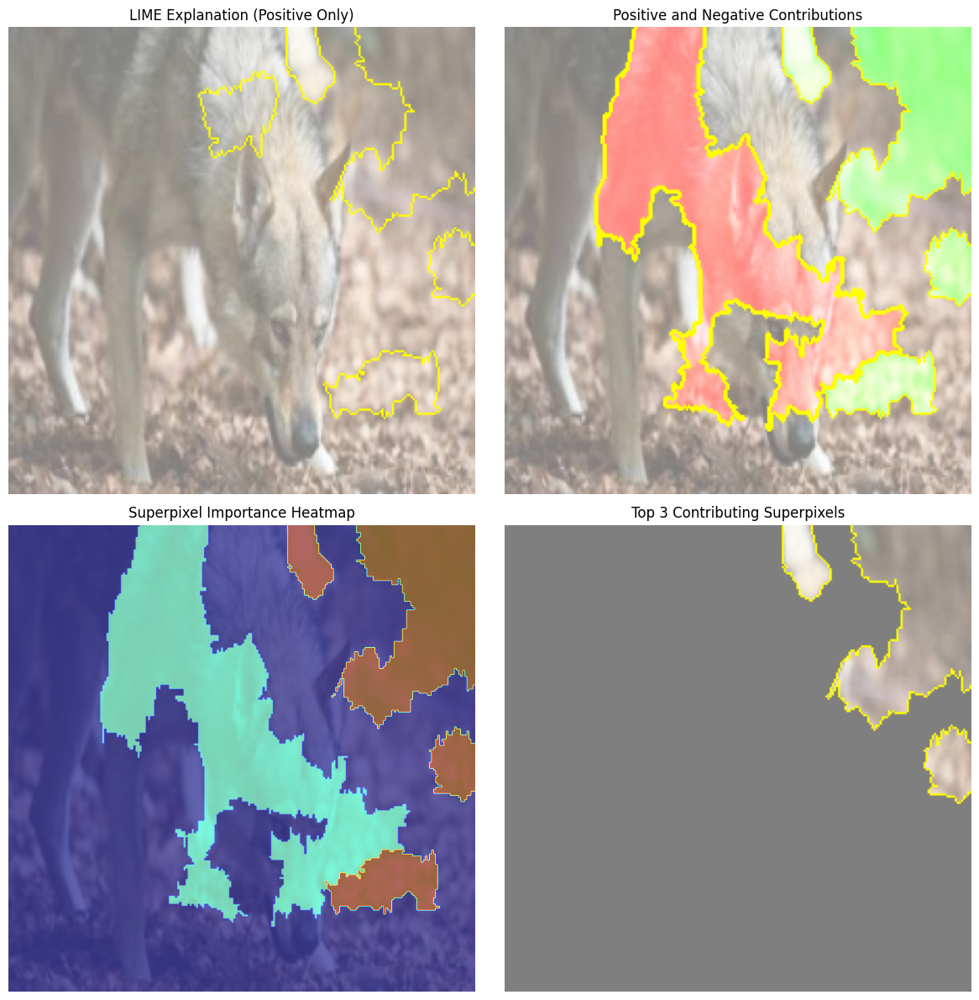

------------------------------------------------------------------------------------------------------------------------


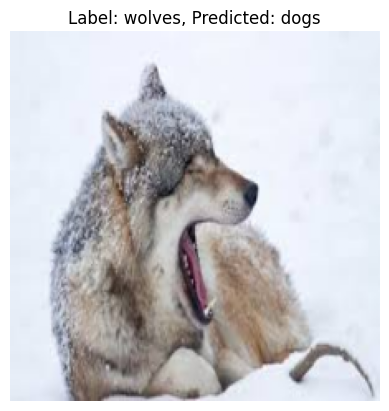

100%|███████████████████████████████████████| 1000/1000 [00:11<00:00, 84.16it/s]


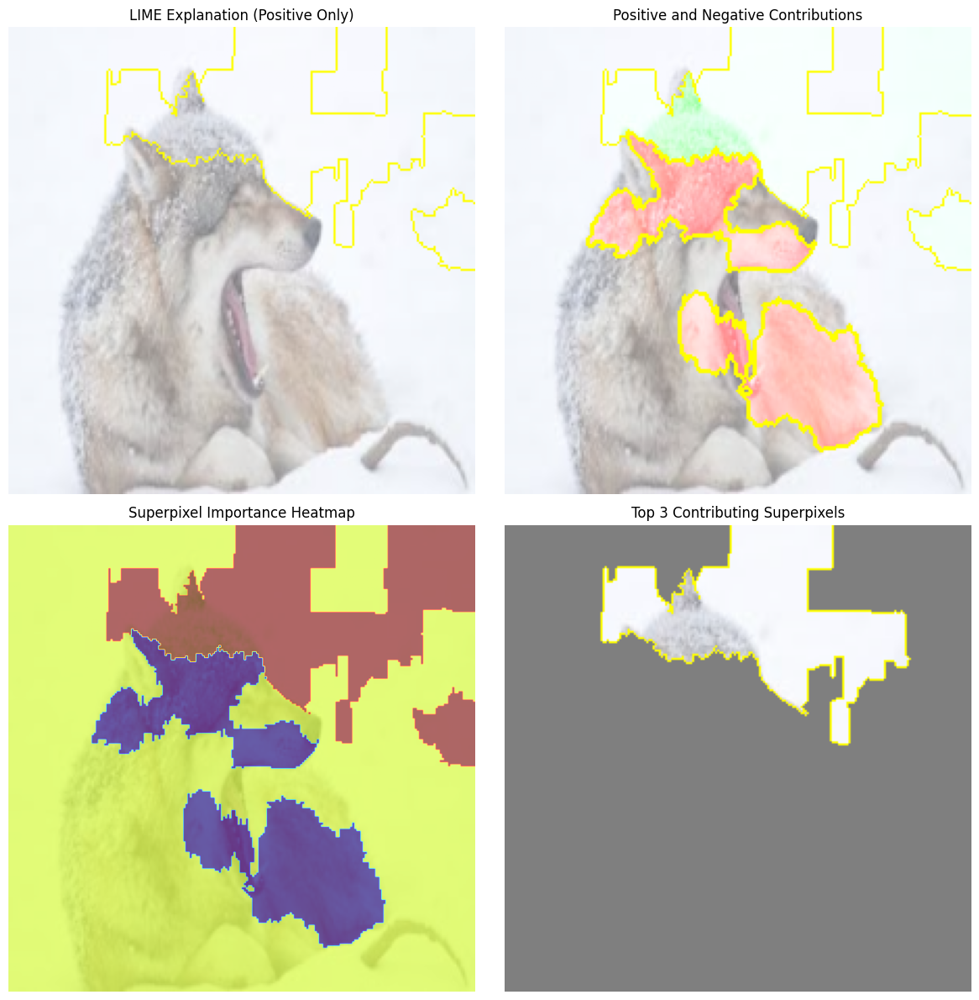

------------------------------------------------------------------------------------------------------------------------


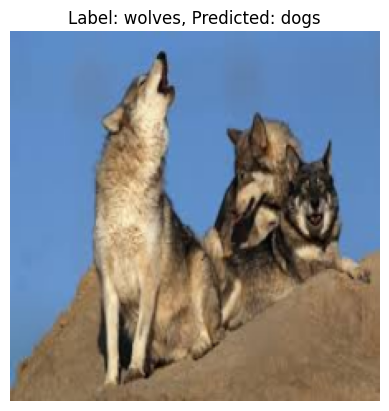

100%|███████████████████████████████████████| 1000/1000 [00:11<00:00, 89.96it/s]


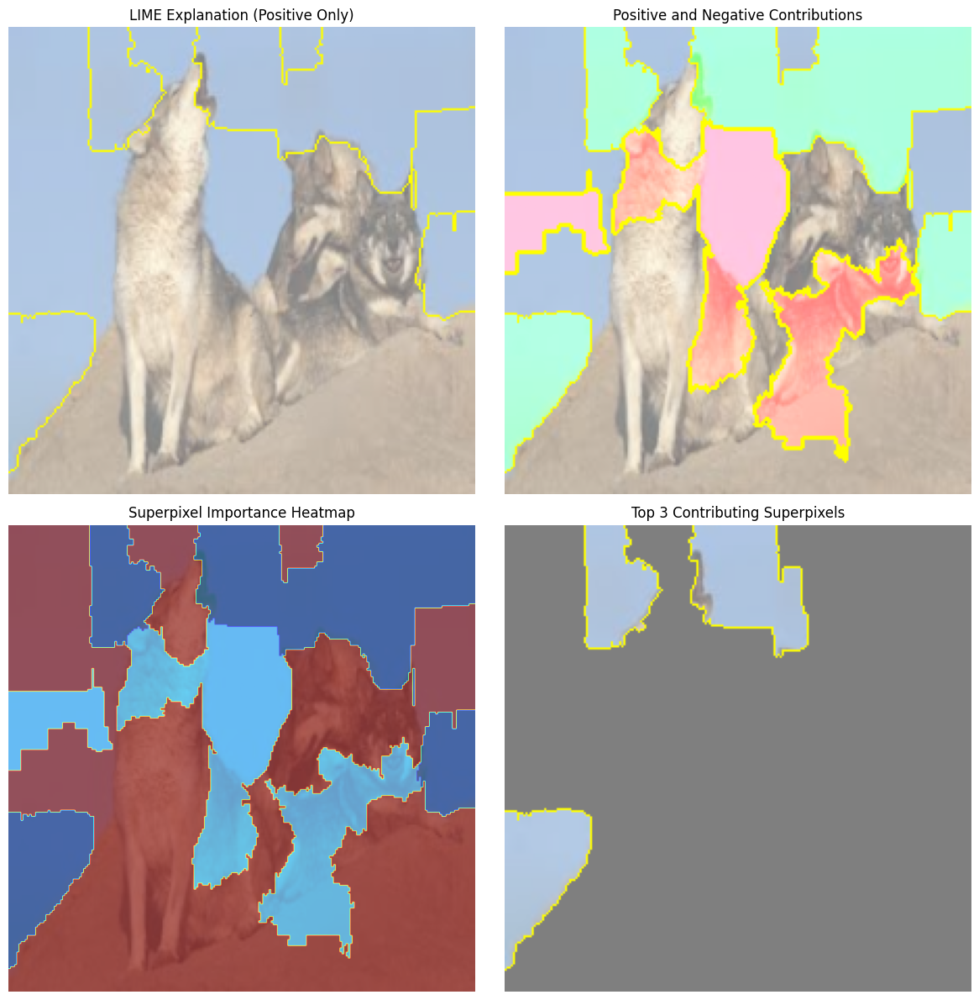

------------------------------------------------------------------------------------------------------------------------


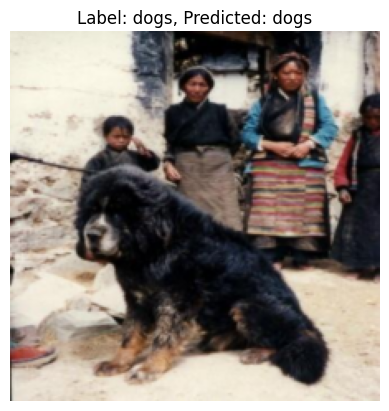

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 94.93it/s]


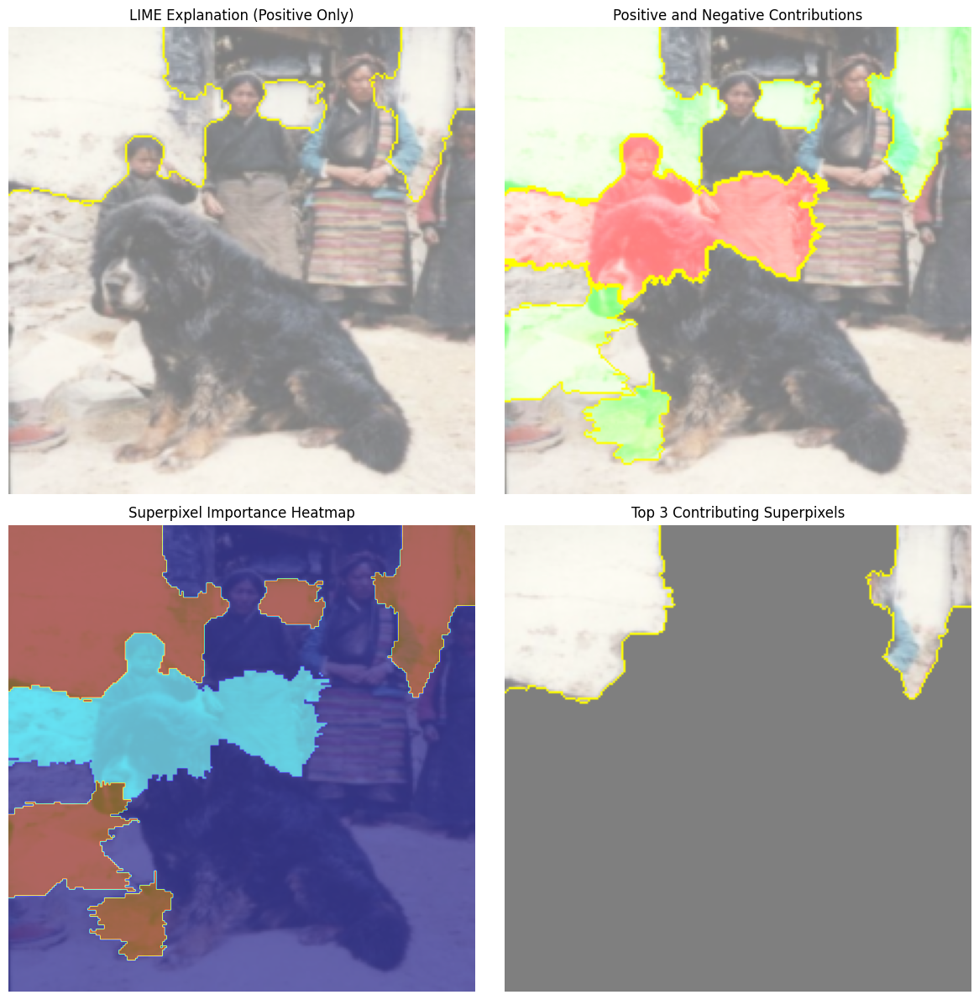

------------------------------------------------------------------------------------------------------------------------


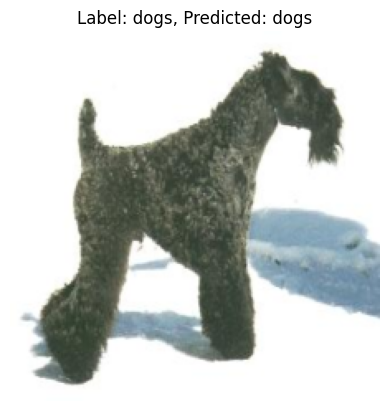

100%|███████████████████████████████████████| 1000/1000 [00:10<00:00, 96.04it/s]


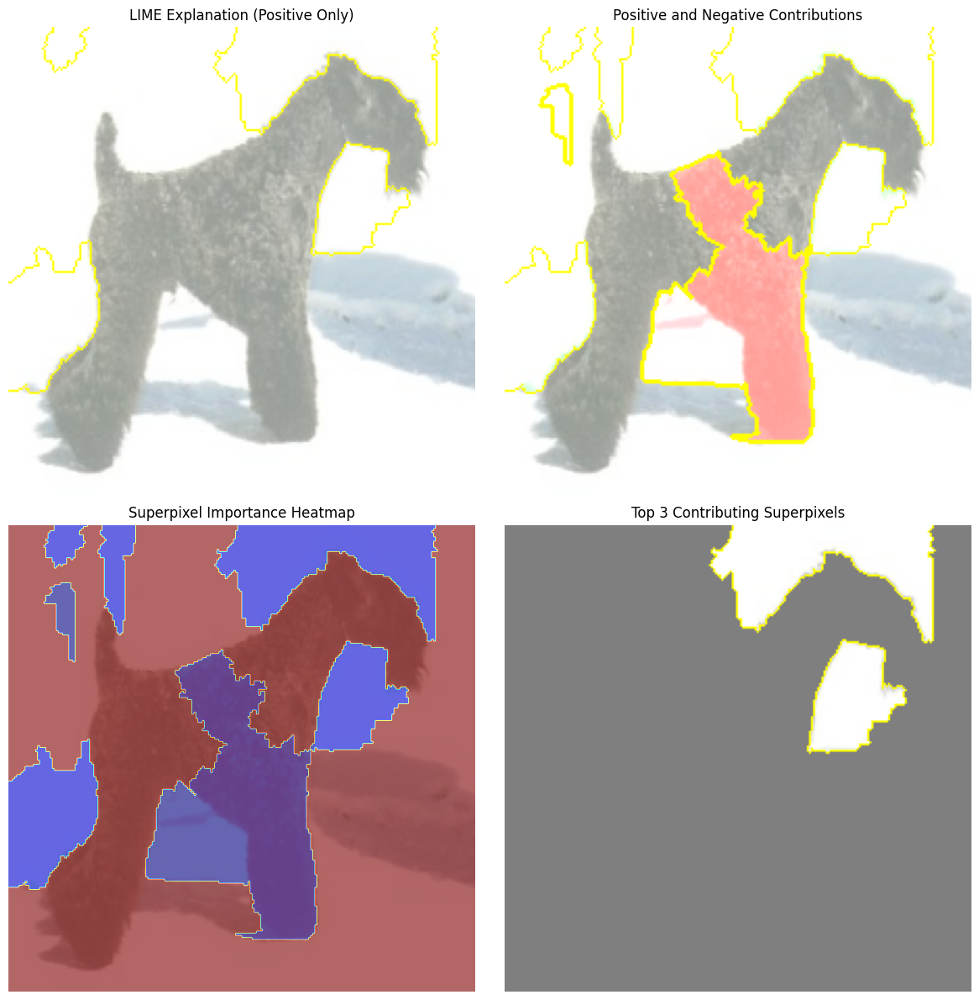

------------------------------------------------------------------------------------------------------------------------


In [23]:
for i in SAMPLE_TEST_IMAGE_INDEXES:
    lime_explain_image(model, sample_images_dicts[i], N_CLASSES, DEVICE)
    print("--------" * 15)

## Step 7 - Retrieve SHAP Explanation

In [24]:
shap_sample_images = []
shap_test_labels = []
for i in SAMPLE_TEST_IMAGE_INDEXES:
    shap_sample_images.append(sample_images_dicts[i]['image'])
    shap_test_labels.append(sample_images_dicts[i]['label'])
shap_sample_images = torch.stack(shap_sample_images)

In [25]:
shap_explainer = shap.DeepExplainer(model, sample_train_images)

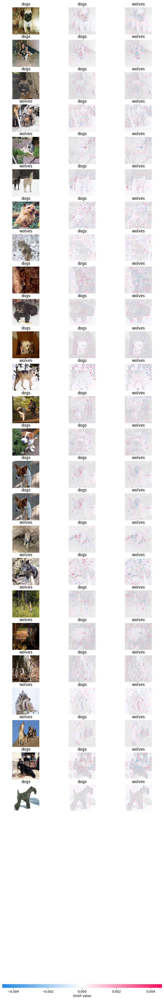

In [26]:
shap_explain_images(shap_explainer, CLASS_NAMES, shap_sample_images, shap_test_labels)

## Step 8 - Retrieve GradCAM Explanation

In [27]:
gradcam = GradCAM(model, target_layer='conv_section.7')

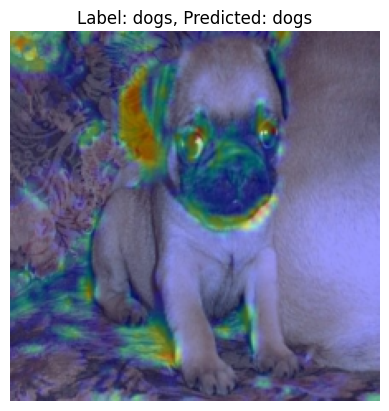

------------------------------------------------------------------------------------------------------------------------


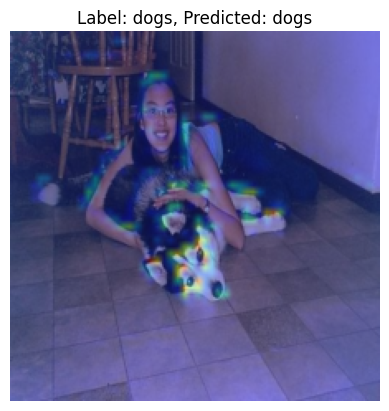

------------------------------------------------------------------------------------------------------------------------


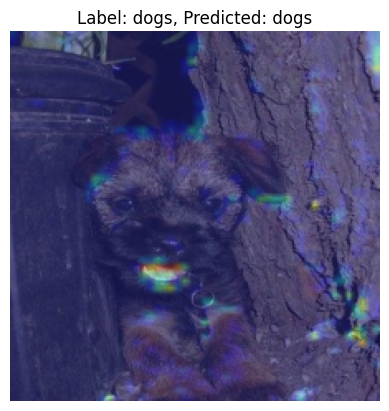

------------------------------------------------------------------------------------------------------------------------


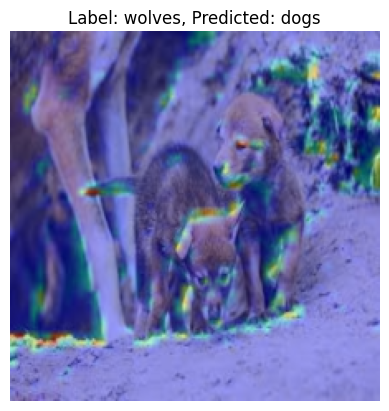

------------------------------------------------------------------------------------------------------------------------


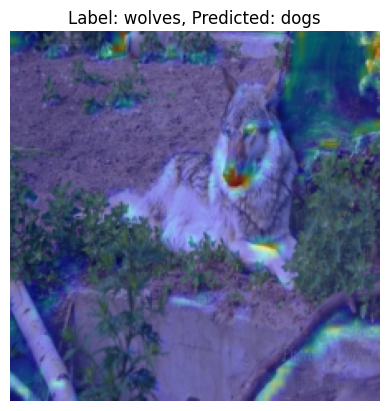

------------------------------------------------------------------------------------------------------------------------


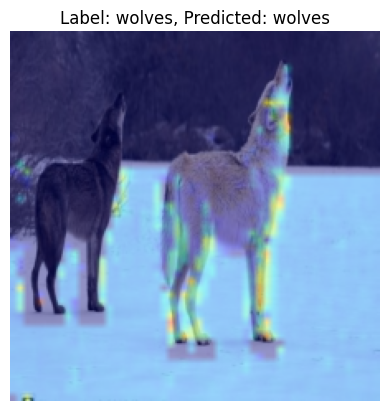

------------------------------------------------------------------------------------------------------------------------


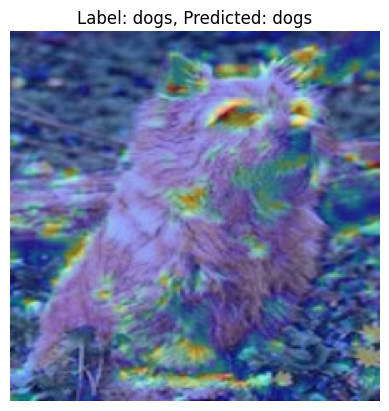

------------------------------------------------------------------------------------------------------------------------


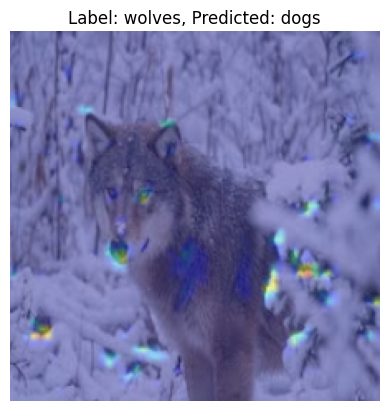

------------------------------------------------------------------------------------------------------------------------


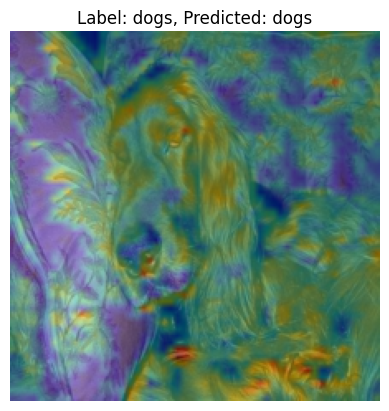

------------------------------------------------------------------------------------------------------------------------


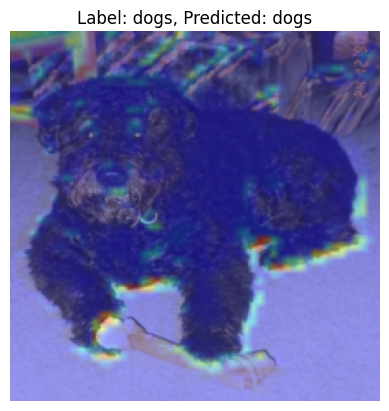

------------------------------------------------------------------------------------------------------------------------


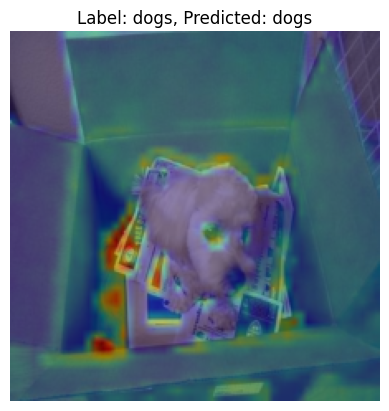

------------------------------------------------------------------------------------------------------------------------


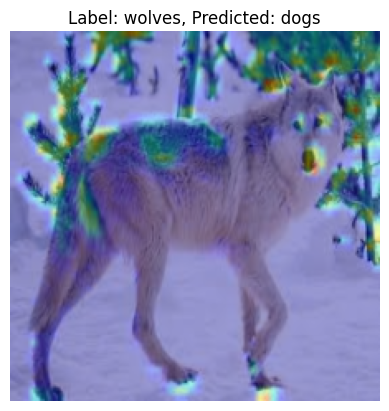

------------------------------------------------------------------------------------------------------------------------


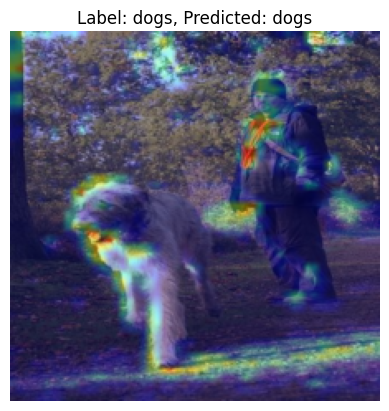

------------------------------------------------------------------------------------------------------------------------


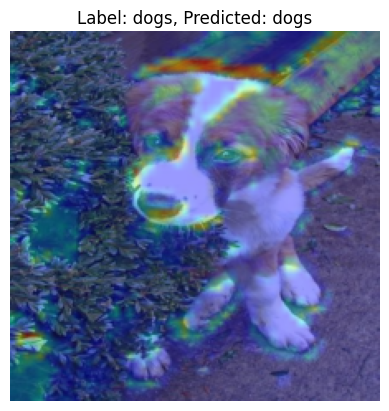

------------------------------------------------------------------------------------------------------------------------


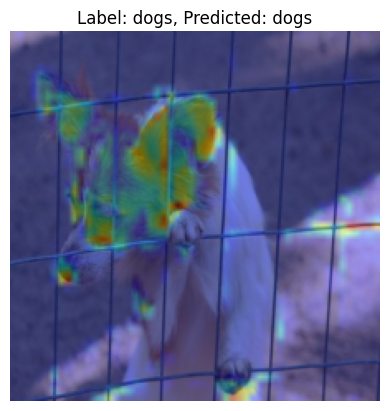

------------------------------------------------------------------------------------------------------------------------


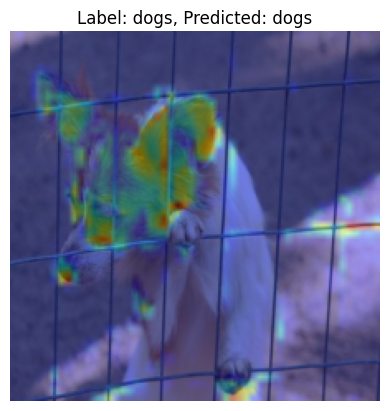

------------------------------------------------------------------------------------------------------------------------


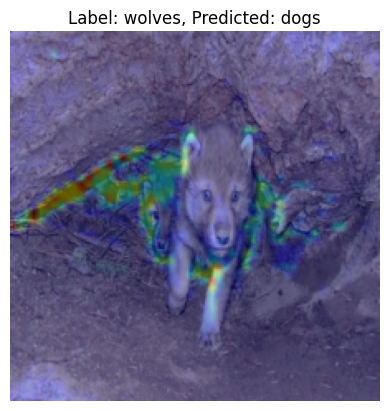

------------------------------------------------------------------------------------------------------------------------


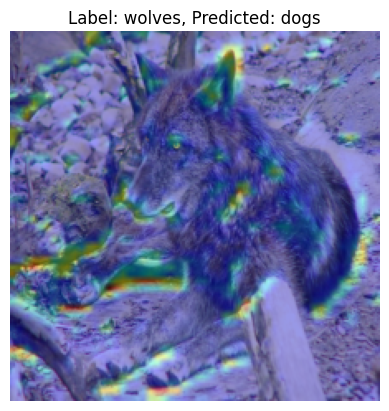

------------------------------------------------------------------------------------------------------------------------


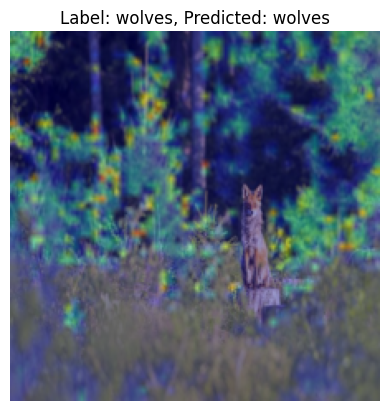

------------------------------------------------------------------------------------------------------------------------


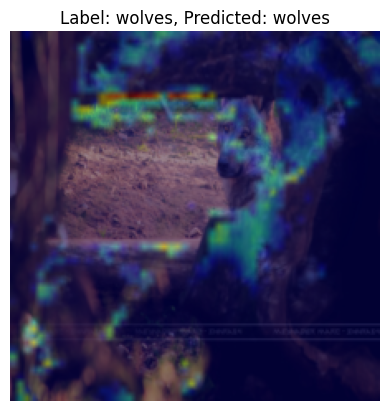

------------------------------------------------------------------------------------------------------------------------


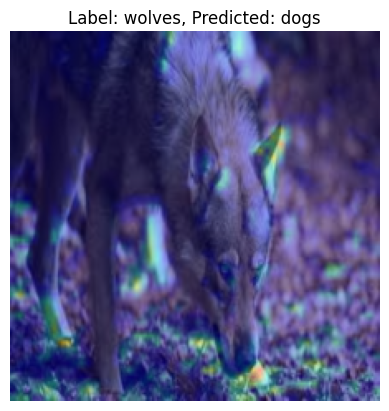

------------------------------------------------------------------------------------------------------------------------


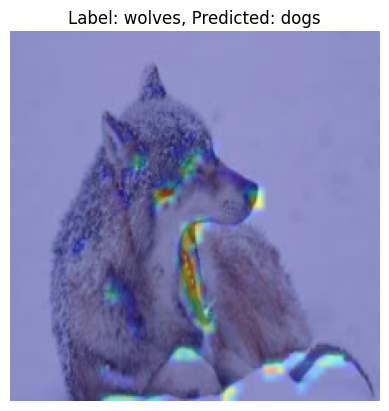

------------------------------------------------------------------------------------------------------------------------


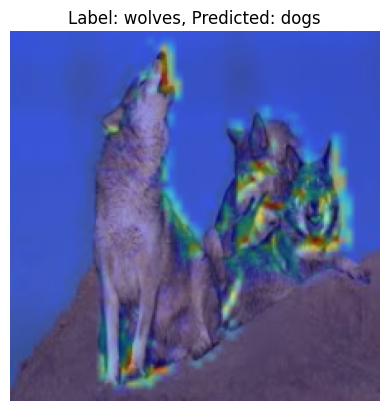

------------------------------------------------------------------------------------------------------------------------


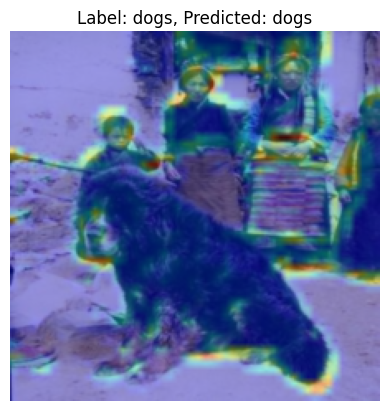

------------------------------------------------------------------------------------------------------------------------


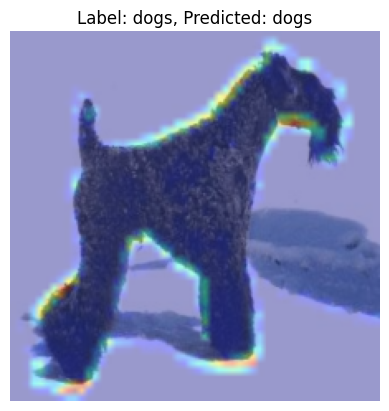

------------------------------------------------------------------------------------------------------------------------


In [28]:
for i in SAMPLE_TEST_IMAGE_INDEXES:
    heatmap = gradcam.generate_heatmap(sample_images_dicts[i]['image'], DEVICE)
    gradcam_explain_image(sample_images_dicts[i], heatmap)
    print("--------" * 15)